<a href="https://colab.research.google.com/github/Mohammed0Arfath/Face-Recognition-System/blob/main/Face_recognition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:

# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES
# TO THE CORRECT LOCATION (/kaggle/input) IN YOUR NOTEBOOK,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

import os
import sys
from tempfile import NamedTemporaryFile
from urllib.request import urlopen
from urllib.parse import unquote, urlparse
from urllib.error import HTTPError
from zipfile import ZipFile
import tarfile
import shutil

CHUNK_SIZE = 40960
DATA_SOURCE_MAPPING = 'face-recognition-dataset:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-data-sets%2F959963%2F1624149%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20240916%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20240916T062412Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3D5eac93822ab05f31b359add2f114b3b9831b3a218f5c70c595427733f4127d54c10381d24762cf5d4124852d00382bf270cbb964fba69ea7389f7244829ba7bad4cd23e2d513b123980dfdeb2475e4da8cd2c6971803af22c7b8683b87d9e8968edb647c78a9e06ff582ac107c094bdcc9397d4f99892dbcab178325f48a53a1102ffb18d5a3de099a2528020b7d90c699e8764281a94895309b7e421ce8b9ca1aebdd781c04d68b0dae79955cb3a06d3bf01772405a34da57b7e760d6bdcf026a8673b12bda87de125be6611a5be70b132aa5dd7b2edf582e05c4ac7b9d61027fbc66a1a5c8ae2df4a5fb66eafe8a65f79f9a76ba77d13846777ca151046dc2'

KAGGLE_INPUT_PATH='/kaggle/input'
KAGGLE_WORKING_PATH='/kaggle/working'
KAGGLE_SYMLINK='kaggle'

!umount /kaggle/input/ 2> /dev/null
shutil.rmtree('/kaggle/input', ignore_errors=True)
os.makedirs(KAGGLE_INPUT_PATH, 0o777, exist_ok=True)
os.makedirs(KAGGLE_WORKING_PATH, 0o777, exist_ok=True)

try:
  os.symlink(KAGGLE_INPUT_PATH, os.path.join("..", 'input'), target_is_directory=True)
except FileExistsError:
  pass
try:
  os.symlink(KAGGLE_WORKING_PATH, os.path.join("..", 'working'), target_is_directory=True)
except FileExistsError:
  pass

for data_source_mapping in DATA_SOURCE_MAPPING.split(','):
    directory, download_url_encoded = data_source_mapping.split(':')
    download_url = unquote(download_url_encoded)
    filename = urlparse(download_url).path
    destination_path = os.path.join(KAGGLE_INPUT_PATH, directory)
    try:
        with urlopen(download_url) as fileres, NamedTemporaryFile() as tfile:
            total_length = fileres.headers['content-length']
            print(f'Downloading {directory}, {total_length} bytes compressed')
            dl = 0
            data = fileres.read(CHUNK_SIZE)
            while len(data) > 0:
                dl += len(data)
                tfile.write(data)
                done = int(50 * dl / int(total_length))
                sys.stdout.write(f"\r[{'=' * done}{' ' * (50-done)}] {dl} bytes downloaded")
                sys.stdout.flush()
                data = fileres.read(CHUNK_SIZE)
            if filename.endswith('.zip'):
              with ZipFile(tfile) as zfile:
                zfile.extractall(destination_path)
            else:
              with tarfile.open(tfile.name) as tarfile:
                tarfile.extractall(destination_path)
            print(f'\nDownloaded and uncompressed: {directory}')
    except HTTPError as e:
        print(f'Failed to load (likely expired) {download_url} to path {destination_path}')
        continue
    except OSError as e:
        print(f'Failed to load {download_url} to path {destination_path}')
        continue

print('Data source import complete.')


[==================================================] 761024670 bytes downloaded
Downloaded and uncompressed: face-recognition-dataset
Data source import complete.


In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

Streaming output truncated to the last 5000 lines.
/kaggle/input/face-recognition-dataset/Original Images/Original Images/Alia Bhatt/Alia Bhatt_51.jpg
/kaggle/input/face-recognition-dataset/Original Images/Original Images/Alia Bhatt/Alia Bhatt_20.jpg
/kaggle/input/face-recognition-dataset/Original Images/Original Images/Alia Bhatt/Alia Bhatt_11.jpg
/kaggle/input/face-recognition-dataset/Original Images/Original Images/Alia Bhatt/Alia Bhatt_62.jpg
/kaggle/input/face-recognition-dataset/Original Images/Original Images/Alia Bhatt/Alia Bhatt_65.jpg
/kaggle/input/face-recognition-dataset/Original Images/Original Images/Alia Bhatt/Alia Bhatt_44.jpg
/kaggle/input/face-recognition-dataset/Original Images/Original Images/Alia Bhatt/Alia Bhatt_56.jpg
/kaggle/input/face-recognition-dataset/Original Images/Original Images/Alia Bhatt/Alia Bhatt_60.jpg
/kaggle/input/face-recognition-dataset/Original Images/Original Images/Alia Bhatt/Alia Bhatt_37.jpg
/kaggle/input/face-recognition-dataset/Original I

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install imgbeddings

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.2/13.2 MB 91.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 8.7 MB/s eta 0:00:00
  Created wheel for imgbeddings: filename=imgbeddings-0.1.0-py3-none-any.whl size=9323 sha256=af4531283e75cba107340b2c836a5e83a032f3bfab3abaeaaa872a234002adde
  Stored in directory: /root/.cache/pip/wheels/4e/c9/9c/5f94fd783ce863540e5999f4bc2afd1501ddaea942ee6413fc
Successfully built imgbeddings


In [ ]:
import cv2
import numpy as np
import os
import pickle
from imgbeddings import imgbeddings  # Ensure this is correctly installed and imported
from PIL import Image

# Define the dataset directory
dataset_dir = '/kaggle/input/face-recognition-dataset/Original Images/Original Images'  # Replace with the actual path to the dataset

# Create 'data' directory if it doesn't exist
if not os.path.exists('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data'):
    os.makedirs('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data')

# Initialize YuNet for face detection
yunet = cv2.FaceDetectorYN.create(
    model='/content/drive/MyDrive/Colab Notebooks/Face Recognition/face_detection_yunet_2023mar.onnx',
    config='',
    input_size=(320, 320),
    score_threshold=0.9,  # Adjust this threshold as needed
    nms_threshold=0.3,
    top_k=5000
)

# Load existing data if available
if os.path.exists('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data/face_data.pkl') and os.path.exists('data/labels.pkl'):
    with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data/face_data.pkl', 'rb') as f:
        face_data = pickle.load(f)
    with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data/labels.pkl', 'rb') as f:
        labels = pickle.load(f)

    # Convert to list if necessary
    if isinstance(face_data, np.ndarray):
        face_data = face_data.tolist()
    if isinstance(labels, np.ndarray):
        labels = labels.tolist()
else:
    face_data = []
    labels = []

ibed = imgbeddings()

# Iterate through each folder in the dataset
for folder_name in os.listdir(dataset_dir):
    person_dir = os.path.join(dataset_dir, folder_name)
    if os.path.isdir(person_dir):
        print(f"Processing faces for {folder_name}")

        # Iterate through each image in the folder
        for image_name in os.listdir(person_dir):
            image_path = os.path.join(person_dir, image_name)

            # Read the image
            img = cv2.imread(image_path)
            if img is None:
                continue

            # Resize image for YuNet input
            height, width, _ = img.shape
            yunet.setInputSize((width, height))

            # Detect faces
            faces = yunet.detect(img)

            if faces[1] is not None:  # Check if any faces were detected
                for face in faces[1]:
                  # Extract face coordinates
                  x, y, w, h = face[:4].astype(int)

                  # Ensure face coordinates are within image bounds
                  x = max(0, x)
                  y = max(0, y)
                  w = min(w, width - x)
                  h = min(h, height - y)

                  # Check if the crop dimensions are valid
                  if w > 0 and h > 0:
                      crop_img = img[y:y+h, x:x+w, :]
                      resized_img = cv2.resize(crop_img, (50, 50))

                      # Convert to PIL Image and get embedding
                      img_pil = Image.fromarray(cv2.cvtColor(resized_img, cv2.COLOR_BGR2RGB))
                      embedding = ibed.to_embeddings(img_pil)
                      face_data.append(embedding[0])
                      labels.append(folder_name)
                  else:
                      print(f"Skipping invalid face region for {folder_name} in image {image_name}")

# Save the face embeddings and labels
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data/face_data.pkl', 'wb') as f:
    pickle.dump(np.array(face_data), f)
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data/labels.pkl', 'wb') as f:
    pickle.dump(np.array(labels), f)

print("Data processing complete.")

In [ ]:
!pip install face_recognition

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100.1/100.1 MB 7.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for face-recognition-models: filename=face_recognition_models-0.3.0-py2.py3-none-any.whl size=100566164 sha256=1372632715d67ab453fa22320aa6f12feb707f9356c02c5afe02bc9570310c17
  Stored in directory: /root/.cache/pip/wheels/7a/eb/cf/e9eced74122b679557f597bb7c8e4c739cfcac526db1fd523d
Successfully built face-recognition-models


In [ ]:
import cv2
import numpy as np
import os
import pickle
import face_recognition  # Using face_recognition for face encodings
from PIL import Image

# Define the dataset directory
dataset_dir = '/kaggle/input/face-recognition-dataset/Original Images/Original Images'  # Replace with the actual path to the dataset

# Create 'data' directory if it doesn't exist
if not os.path.exists('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data2'):
    os.makedirs('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data2')

# Load existing data if available
if os.path.exists('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data2/face_data.pkl') and os.path.exists('data2/labels.pkl'):
    with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data2/face_data.pkl', 'rb') as f:
        face_data = pickle.load(f)
    with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data2/labels.pkl', 'rb') as f:
        labels = pickle.load(f)

    # Convert to list if necessary
    if isinstance(face_data, np.ndarray):
        face_data = face_data.tolist()
    if isinstance(labels, np.ndarray):
        labels = labels.tolist()
else:
    face_data = []
    labels = []

# Iterate through each folder in the dataset
for folder_name in os.listdir(dataset_dir):
    person_dir = os.path.join(dataset_dir, folder_name)
    if os.path.isdir(person_dir):
        print(f"Processing faces for {folder_name}")

        # Iterate through each image in the folder
        for image_name in os.listdir(person_dir):
            image_path = os.path.join(person_dir, image_name)

            # Read the image
            img = cv2.imread(image_path)
            if img is None:
                continue

            # Convert image from BGR (OpenCV format) to RGB (face_recognition format)
            rgb_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

            # Detect faces using face_recognition
            face_locations = face_recognition.face_locations(rgb_img)

            if face_locations:  # Check if any faces were detected
                for face_location in face_locations:
                    # Extract face coordinates
                    top, right, bottom, left = face_location

                    # Crop the face
                    crop_img = rgb_img[top:bottom, left:right]

                    # Resize the cropped face to a fixed size (if necessary)
                    resized_img = cv2.resize(crop_img, (50, 50))

                    # Generate face encoding
                    face_encoding = face_recognition.face_encodings(rgb_img, [face_location])

                    if face_encoding:
                        face_data.append(face_encoding[0])  # Append the encoding
                        labels.append(folder_name)  # Append the label

                    else:
                        print(f"Skipping face for {folder_name} in image {image_name} (encoding failed)")
            else:
                print(f"No faces detected for {folder_name} in image {image_name}")

# Save the face encodings and labels
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data2/face_data.pkl', 'wb') as f:
    pickle.dump(np.array(face_data), f)
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data2/labels.pkl', 'wb') as f:
    pickle.dump(np.array(labels), f)

print("Data processing complete.")


Processing faces for Priyanka Chopra
Processing faces for Alia Bhatt
Processing faces for Margot Robbie
Processing faces for Brad Pitt
Processing faces for Natalie Portman
Processing faces for Amitabh Bachchan
Processing faces for Claire Holt
No faces detected for Claire Holt in image Claire Holt_42.jpg
Processing faces for Jessica Alba
Processing faces for Virat Kohli
Processing faces for Ellen Degeneres
Processing faces for Kashyap
Processing faces for Hrithik Roshan
No faces detected for Hrithik Roshan in image Hrithik Roshan_23.jpg
No faces detected for Hrithik Roshan in image Hrithik Roshan_27.jpg
No faces detected for Hrithik Roshan in image Hrithik Roshan_69.jpg
Processing faces for Zac Efron
Processing faces for Elizabeth Olsen
Processing faces for Courtney Cox
Processing faces for Alexandra Daddario
No faces detected for Alexandra Daddario in image Alexandra Daddario_51.jpg
Processing faces for Anushka Sharma
Processing faces for Andy Samberg
Processing faces for Robert Downey

In [ ]:
!pip install insightface onnxruntime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 439.5/439.5 kB 24.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.2/13.2 MB 113.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 81.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 8.4 MB/s eta 0:00:00
  Created wheel for insightface: filename=insightface-0.7.3-cp310-cp310-linux_x86_64.whl size=1055395 sha256=568c8b8c12d9a18924575ec86a4e5de24fef5a85d7114c5946811c6e23406118
  Stored in directory: /root/.cache/pip/wheels/e3/d0/80/e3773fb8b6d1cca87ea1d33d9b1f20a223a6493c896da249b5
Successfully built insightface


In [ ]:
import cv2
import numpy as np
import os
import pickle
import insightface
from insightface.app import FaceAnalysis

# Define the dataset directory
dataset_dir = '/kaggle/input/face-recognition-dataset/Original Images/Original Images'  # Replace with the actual path to the dataset

# Create 'data' directory if it doesn't exist
if not os.path.exists('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3'):
    os.makedirs('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3')

# Initialize ArcFace model (InsightFace)
def load_arcface_model():
    app = FaceAnalysis(providers=['CUDAExecutionProvider', 'CPUExecutionProvider'])  # Using GPU if available
    app.prepare(ctx_id=0, det_size=(640, 640))  # Prepare the face detection and embedding model
    return app

arcface_model = load_arcface_model()

# Load existing data if available
if os.path.exists('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/face_data.pkl') and os.path.exists('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/labels.pkl'):
    with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/face_data.pkl', 'rb') as f:
        face_data = pickle.load(f)
    with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/labels.pkl', 'rb') as f:
        labels = pickle.load(f)

    # Convert to list if necessary
    if isinstance(face_data, np.ndarray):
        face_data = face_data.tolist()
    if isinstance(labels, np.ndarray):
        labels = labels.tolist()
else:
    face_data = []
    labels = []

# Iterate through each folder in the dataset
for folder_name in os.listdir(dataset_dir):
    person_dir = os.path.join(dataset_dir, folder_name)
    if os.path.isdir(person_dir):
        print(f"Processing faces for {folder_name}")

        # Iterate through each image in the folder
        for image_name in os.listdir(person_dir):
            image_path = os.path.join(person_dir, image_name)

            # Read the image
            img = cv2.imread(image_path)
            if img is None:
                continue

            # Detect faces and get embeddings using ArcFace
            faces = arcface_model.get(img)

            if faces:
                for face in faces:
                    # Get the embedding (normalized ArcFace embeddings)
                    embedding = face.normed_embedding

                    # Append embedding and label
                    face_data.append(embedding)
                    labels.append(folder_name)

            else:
                print(f"No faces detected for {folder_name} in image {image_name}")

# Save the face embeddings and labels
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/face_data.pkl', 'wb') as f:
    pickle.dump(np.array(face_data), f)
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/labels.pkl', 'wb') as f:
    pickle.dump(np.array(labels), f)

print("Data processing complete.")


download_path: /root/.insightface/models/buffalo_l


100%|██████████| 281857/281857 [00:08<00:00, 35185.86KB/s]
/usr/local/lib/python3.10/dist-packages/onnxruntime/capi/onnxruntime_inference_collection.py:69: UserWarning: Specified provider 'CUDAExecutionProvider' is not in available provider names.Available providers: 'AzureExecutionProvider, CPUExecutionProvider'
  warnings.warn(


Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/1k3d68.onnx landmark_3d_68 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/2d106det.onnx landmark_2d_106 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/det_10g.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/genderage.onnx genderage ['None', 3, 96, 96] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/w600k_r50.onnx recognition ['None', 3, 112, 112] 127.5 127.5
set det-size: (640, 640)
Processing f

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


Processing faces for Alia Bhatt
Processing faces for Margot Robbie
Processing faces for Brad Pitt
Processing faces for Natalie Portman
Processing faces for Amitabh Bachchan
Processing faces for Claire Holt
Processing faces for Jessica Alba
No faces detected for Jessica Alba in image Jessica Alba_30.jpg
Processing faces for Virat Kohli
Processing faces for Ellen Degeneres
Processing faces for Kashyap
Processing faces for Hrithik Roshan
No faces detected for Hrithik Roshan in image Hrithik Roshan_17.jpg
Processing faces for Zac Efron
No faces detected for Zac Efron in image Zac Efron_13.jpg
Processing faces for Elizabeth Olsen
No faces detected for Elizabeth Olsen in image Elizabeth Olsen_16.jpg
Processing faces for Courtney Cox
Processing faces for Alexandra Daddario
Processing faces for Anushka Sharma
Processing faces for Andy Samberg
Processing faces for Robert Downey Jr
No faces detected for Robert Downey Jr in image Robert Downey Jr_14.jpg
Processing faces for Charlize Theron
No fac

In [ ]:
import cv2
import numpy as np
import os
import pickle
import insightface
from insightface.app import FaceAnalysis

# Define the dataset directory
dataset_dir = '/content/drive/MyDrive/Colab Notebooks/Face Recognition/Photos'  # Replace with the actual path to the dataset

# Create 'data' directory if it doesn't exist
if not os.path.exists('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3'):
    os.makedirs('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3')

# Initialize ArcFace model (InsightFace)
def load_arcface_model():
    app = FaceAnalysis(providers=['CUDAExecutionProvider', 'CPUExecutionProvider'])  # Using GPU if available
    app.prepare(ctx_id=0, det_size=(640, 640))  # Prepare the face detection and embedding model
    return app

arcface_model = load_arcface_model()

# Load existing data if available
if os.path.exists('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/face_data.pkl') and os.path.exists('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/labels.pkl'):
    with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/face_data.pkl', 'rb') as f:
        face_data = pickle.load(f)
    with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/labels.pkl', 'rb') as f:
        labels = pickle.load(f)

    # Convert to list if necessary
    if isinstance(face_data, np.ndarray):
        face_data = face_data.tolist()
    if isinstance(labels, np.ndarray):
        labels = labels.tolist()
else:
    face_data = []
    labels = []

# Iterate through each folder in the dataset
for folder_name in os.listdir(dataset_dir):
    person_dir = os.path.join(dataset_dir, folder_name)
    if os.path.isdir(person_dir):
        print(f"Processing faces for {folder_name}")

        # Iterate through each image in the folder
        for image_name in os.listdir(person_dir):
            image_path = os.path.join(person_dir, image_name)

            # Read the image
            img = cv2.imread(image_path)
            if img is None:
                continue

            # Detect faces and get embeddings using ArcFace
            faces = arcface_model.get(img)

            if faces:
                for face in faces:
                    # Get the embedding (normalized ArcFace embeddings)
                    embedding = face.normed_embedding

                    # Append embedding and label
                    face_data.append(embedding)
                    labels.append(folder_name)
            else:
                print(f"No faces detected for {folder_name} in image {image_name}")

# Save the face embeddings and labels
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/face_data.pkl', 'wb') as f:
    pickle.dump(np.array(face_data), f)
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/labels.pkl', 'wb') as f:
    pickle.dump(np.array(labels), f)

print("Data processing complete.")


Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/1k3d68.onnx landmark_3d_68 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/2d106det.onnx landmark_2d_106 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/det_10g.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/genderage.onnx genderage ['None', 3, 96, 96] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/w600k_r50.onnx recognition ['None', 3, 112, 112] 127.5 127.5
set det-size: (640, 640)
Processing f

In [ ]:
!pip install facenet-pytorch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 40.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 103.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 755.5/755.5 MB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 72.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 60.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 44.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 800.4 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 8.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 15.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1

In [ ]:
import cv2
import numpy as np
import os
import pickle
import torch
from facenet_pytorch import MTCNN, InceptionResnetV1

# Define the dataset directory
dataset_dir = '/kaggle/input/face-recognition-dataset/Original Images/Original Images'  # Replace with the actual path to the dataset

# Create 'data' directory if it doesn't exist
if not os.path.exists('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data4'):
    os.makedirs('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data4')

# Initialize FaceNet model
mtcnn = MTCNN(keep_all=True)  # MTCNN for face detection
resnet = InceptionResnetV1(pretrained='vggface2').eval()  # FaceNet model for embeddings

# Load existing data if available
if os.path.exists('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data4/face_data.pkl') and os.path.exists('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data4/labels.pkl'):
    with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data4/face_data.pkl', 'rb') as f:
        face_data = pickle.load(f)
    with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data4/labels.pkl', 'rb') as f:
        labels = pickle.load(f)

    # Convert to list if necessary
    if isinstance(face_data, np.ndarray):
        face_data = face_data.tolist()
    if isinstance(labels, np.ndarray):
        labels = labels.tolist()
else:
    face_data = []
    labels = []

# Minimum face size to avoid errors (set to 160x160, the expected input size for FaceNet)
FIXED_FACE_SIZE = (160, 160)

# Iterate through each folder in the dataset
for folder_name in os.listdir(dataset_dir):
    person_dir = os.path.join(dataset_dir, folder_name)
    if os.path.isdir(person_dir):
        print(f"Processing faces for {folder_name}")

        # Iterate through each image in the folder
        for image_name in os.listdir(person_dir):
            image_path = os.path.join(person_dir, image_name)

            # Read the image
            img = cv2.imread(image_path)
            if img is None:
                print(f"Error reading image {image_name}, skipping.")
                continue

            # Detect faces using MTCNN (face detector from FaceNet)
            boxes, _ = mtcnn.detect(img)

            if boxes is not None:
                for box in boxes:
                    # Extract face coordinates
                    x1, y1, x2, y2 = [int(b) for b in box]
                    face = img[y1:y2, x1:x2]

                    # Ensure the face crop is valid (non-empty)
                    if face.size == 0:
                        print(f"Skipping empty face for {folder_name} in image {image_name}")
                        continue

                    # Resize the face to the fixed size (160x160)
                    face_resized = cv2.resize(face, FIXED_FACE_SIZE)

                    # Convert face to RGB and get embedding
                    face_resized_rgb = cv2.cvtColor(face_resized, cv2.COLOR_BGR2RGB)  # Convert to RGB
                    face_tensor = torch.tensor(face_resized_rgb).permute(2, 0, 1).unsqueeze(0).float() / 255.0  # Convert to tensor
                    embedding = resnet(face_tensor).detach().numpy()[0]  # Get embedding

                    # Append embedding and label
                    face_data.append(embedding)
                    labels.append(folder_name)

            else:
                print(f"No faces detected for {folder_name} in image {image_name}")

# Save the face embeddings and labels
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data4/face_data.pkl', 'wb') as f:
    pickle.dump(np.array(face_data), f)
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data4/labels.pkl', 'wb') as f:
    pickle.dump(np.array(labels), f)

print("Data processing complete.")


Processing faces for Priyanka Chopra
No faces detected for Priyanka Chopra in image Priyanka Chopra_2.jpg
Skipping empty face for Priyanka Chopra in image Priyanka Chopra_59.jpg
No faces detected for Priyanka Chopra in image Priyanka Chopra_84.jpg
Processing faces for Alia Bhatt
No faces detected for Alia Bhatt in image Alia Bhatt_40.jpg
No faces detected for Alia Bhatt in image Alia Bhatt_52.jpg
Processing faces for Margot Robbie
Processing faces for Brad Pitt
No faces detected for Brad Pitt in image Brad Pitt_0.jpg
Skipping empty face for Brad Pitt in image Brad Pitt_11.jpg
Processing faces for Natalie Portman
Skipping empty face for Natalie Portman in image Natalie Portman_3.jpg
Processing faces for Amitabh Bachchan
No faces detected for Amitabh Bachchan in image Amitabh Bachchan_10.jpg
No faces detected for Amitabh Bachchan in image Amitabh Bachchan_42.jpg
No faces detected for Amitabh Bachchan in image Amitabh Bachchan_5.jpg
No faces detected for Amitabh Bachchan in image Amitabh 

In [ ]:
import numpy as np
import pickle
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.metrics import classification_report

In [ ]:
# Load the embeddings and labels
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data/face_data.pkl', 'rb') as f:
    face_data = pickle.load(f)
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data/labels.pkl', 'rb') as f:
    labels = pickle.load(f)

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(face_data, labels, test_size=0.2, random_state=42)

# Dictionary of models
models = {
    'KNN': KNeighborsClassifier(n_neighbors=5),
    'SVM': SVC(probability=True),
    'MLP': MLPClassifier(hidden_layer_sizes=(100,), max_iter=500),
    'AdaBoost': AdaBoostClassifier(n_estimators=50),
    'LDA':LinearDiscriminantAnalysis()
}

# Function to train and save models
def train_model(model_name, model):
    print(f"Training {model_name}...")
    model.fit(X_train, y_train)

    # Save the trained model
    with open(f'/content/drive/MyDrive/Colab Notebooks/Face Recognition/models/{model_name.lower().replace(" ", "_")}_model.pkl', 'wb') as f:
        pickle.dump(model, f)

    y_pred = model.predict(X_test)

    # Print test accuracy
    test_accuracy = model.score(X_test, y_test)
    print(f"{model_name} Test Accuracy: {test_accuracy:.2f}")
    print(f"{model_name} Classification Report:\n{classification_report(y_test, y_pred)}")

# Train and save all models
for model_name, model in models.items():
    train_model(model_name, model)

Training KNN...
KNN Test Accuracy: 0.94
KNN Classification Report:
                    precision    recall  f1-score   support

      Akshay Kumar       0.91      1.00      0.95        10
Alexandra Daddario       0.83      1.00      0.91        10
        Alia Bhatt       0.92      0.86      0.89        14
  Amitabh Bachchan       1.00      1.00      1.00        14
      Andy Samberg       0.90      1.00      0.95        19
    Anushka Sharma       0.89      0.80      0.84        10
     Billie Eilish       1.00      1.00      1.00        13
         Brad Pitt       1.00      0.92      0.96        25
    Camila Cabello       1.00      0.92      0.96        13
   Charlize Theron       0.80      0.67      0.73         6
       Claire Holt       0.64      0.78      0.70         9
      Courtney Cox       0.95      1.00      0.98        21
    Dwayne Johnson       1.00      1.00      1.00         9
   Elizabeth Olsen       0.90      0.82      0.86        11
   Ellen Degeneres       1.00   

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


LDA Test Accuracy: 0.97
LDA Classification Report:
                    precision    recall  f1-score   support

      Akshay Kumar       1.00      1.00      1.00        10
Alexandra Daddario       0.83      1.00      0.91        10
        Alia Bhatt       0.93      1.00      0.97        14
  Amitabh Bachchan       1.00      1.00      1.00        14
      Andy Samberg       0.95      1.00      0.97        19
    Anushka Sharma       1.00      1.00      1.00        10
     Billie Eilish       1.00      1.00      1.00        13
         Brad Pitt       1.00      0.96      0.98        25
    Camila Cabello       1.00      1.00      1.00        13
   Charlize Theron       1.00      1.00      1.00         6
       Claire Holt       0.80      0.89      0.84         9
      Courtney Cox       1.00      0.95      0.98        21
    Dwayne Johnson       1.00      1.00      1.00         9
   Elizabeth Olsen       1.00      0.82      0.90        11
   Ellen Degeneres       1.00      1.00      1.0

In [ ]:
# Load the embeddings and labels
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data2/face_data.pkl', 'rb') as f:
    face_data = pickle.load(f)
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data2/labels.pkl', 'rb') as f:
    labels = pickle.load(f)

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(face_data, labels, test_size=0.2, random_state=42)

# Dictionary of models
models = {
    'KNN': KNeighborsClassifier(n_neighbors=5),
    'SVM': SVC(probability=True),
    'MLP': MLPClassifier(hidden_layer_sizes=(100,), max_iter=500),
    'AdaBoost': AdaBoostClassifier(n_estimators=50),
    'LDA':LinearDiscriminantAnalysis()
}

# Function to train and save models
def train_model(model_name, model):
    print(f"Training {model_name}...")
    model.fit(X_train, y_train)

    # Save the trained model
    with open(f'/content/drive/MyDrive/Colab Notebooks/Face Recognition/models2/{model_name.lower().replace(" ", "_")}_model.pkl', 'wb') as f:
        pickle.dump(model, f)

    y_pred = model.predict(X_test)

    # Print test accuracy
    test_accuracy = model.score(X_test, y_test)
    print(f"{model_name} Test Accuracy: {test_accuracy:.2f}")
    print(f"{model_name} Classification Report:\n{classification_report(y_test, y_pred)}")

# Train and save all models
for model_name, model in models.items():
    train_model(model_name, model)

Training KNN...
KNN Test Accuracy: 0.98
KNN Classification Report:
                    precision    recall  f1-score   support

      Akshay Kumar       0.92      0.92      0.92        12
Alexandra Daddario       1.00      1.00      1.00        15
        Alia Bhatt       0.84      1.00      0.91        16
  Amitabh Bachchan       1.00      1.00      1.00        14
      Andy Samberg       0.96      1.00      0.98        23
    Anushka Sharma       1.00      1.00      1.00        16
     Billie Eilish       1.00      0.96      0.98        27
         Brad Pitt       1.00      0.94      0.97        17
    Camila Cabello       1.00      0.93      0.97        15
   Charlize Theron       1.00      1.00      1.00        17
       Claire Holt       0.91      0.95      0.93        22
      Courtney Cox       1.00      1.00      1.00        14
    Dwayne Johnson       1.00      1.00      1.00         8
   Elizabeth Olsen       1.00      1.00      1.00        15
   Ellen Degeneres       1.00   

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
# Load the embeddings and labels
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/face_data.pkl', 'rb') as f:
    face_data = pickle.load(f)
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/labels.pkl', 'rb') as f:
    labels = pickle.load(f)

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(face_data, labels, test_size=0.2, random_state=42)

# Dictionary of models
models = {
    'KNN': KNeighborsClassifier(n_neighbors=5),
    'SVM': SVC(probability=True),
    'MLP': MLPClassifier(hidden_layer_sizes=(100,), max_iter=500),
    'AdaBoost': AdaBoostClassifier(n_estimators=50),
    'LDA':LinearDiscriminantAnalysis()
}

# Function to train and save models
def train_model(model_name, model):
    print(f"Training {model_name}...")
    model.fit(X_train, y_train)

    # Save the trained model
    with open(f'/content/drive/MyDrive/Colab Notebooks/Face Recognition/models3/{model_name.lower().replace(" ", "_")}_model.pkl', 'wb') as f:
        pickle.dump(model, f)

    y_pred = model.predict(X_test)

    # Print test accuracy
    test_accuracy = model.score(X_test, y_test)
    print(f"{model_name} Test Accuracy: {test_accuracy:.2f}")
    print(f"{model_name} Classification Report:\n{classification_report(y_test, y_pred)}")

# Train and save all models
for model_name, model in models.items():
    train_model(model_name, model)

Training KNN...
KNN Test Accuracy: 0.98
KNN Classification Report:
                    precision    recall  f1-score   support

             Affan       1.00      1.00      1.00         2
      Akshay Kumar       1.00      0.89      0.94         9
Alexandra Daddario       1.00      0.96      0.98        23
        Alia Bhatt       1.00      1.00      1.00        16
  Amitabh Bachchan       0.93      1.00      0.97        14
      Andy Samberg       0.96      1.00      0.98        22
    Anushka Sharma       0.88      0.78      0.82         9
            Arfath       1.00      1.00      1.00         3
     Billie Eilish       1.00      1.00      1.00        17
         Brad Pitt       1.00      1.00      1.00        20
    Camila Cabello       1.00      1.00      1.00        18
   Charlize Theron       0.95      1.00      0.97        18
       Claire Holt       1.00      1.00      1.00        18
      Courtney Cox       1.00      1.00      1.00        17
    Dwayne Johnson       0.93   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


AdaBoost Test Accuracy: 0.16
AdaBoost Classification Report:
                    precision    recall  f1-score   support

             Affan       0.00      0.00      0.00         2
      Akshay Kumar       0.00      0.00      0.00         9
Alexandra Daddario       0.00      0.00      0.00        23
        Alia Bhatt       0.00      0.00      0.00        16
  Amitabh Bachchan       0.64      1.00      0.78        14
      Andy Samberg       0.00      0.00      0.00        22
    Anushka Sharma       0.00      0.00      0.00         9
            Arfath       0.00      0.00      0.00         3
     Billie Eilish       0.00      0.00      0.00        17
         Brad Pitt       0.04      0.85      0.07        20
    Camila Cabello       0.00      0.00      0.00        18
   Charlize Theron       0.00      0.00      0.00        18
       Claire Holt       0.00      0.00      0.00        18
      Courtney Cox       0.00      0.00      0.00        17
    Dwayne Johnson       0.00      0.0

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


LDA Test Accuracy: 0.98
LDA Classification Report:
                    precision    recall  f1-score   support

             Affan       1.00      1.00      1.00         2
      Akshay Kumar       1.00      0.89      0.94         9
Alexandra Daddario       1.00      0.96      0.98        23
        Alia Bhatt       1.00      1.00      1.00        16
  Amitabh Bachchan       1.00      1.00      1.00        14
      Andy Samberg       1.00      1.00      1.00        22
    Anushka Sharma       0.89      0.89      0.89         9
            Arfath       1.00      1.00      1.00         3
     Billie Eilish       1.00      1.00      1.00        17
         Brad Pitt       1.00      1.00      1.00        20
    Camila Cabello       1.00      1.00      1.00        18
   Charlize Theron       1.00      1.00      1.00        18
       Claire Holt       1.00      1.00      1.00        18
      Courtney Cox       0.94      1.00      0.97        17
    Dwayne Johnson       1.00      0.93      0.9

In [ ]:
# Load the embeddings and labels
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data4/face_data.pkl', 'rb') as f:
    face_data = pickle.load(f)
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data4/labels.pkl', 'rb') as f:
    labels = pickle.load(f)

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(face_data, labels, test_size=0.2, random_state=42)

# Dictionary of models
models = {
    'KNN': KNeighborsClassifier(n_neighbors=5),
    'SVM': SVC(probability=True),
    'MLP': MLPClassifier(hidden_layer_sizes=(100,), max_iter=500),
    'AdaBoost': AdaBoostClassifier(n_estimators=50),
    'LDA':LinearDiscriminantAnalysis()
}

# Function to train and save models
def train_model(model_name, model):
    print(f"Training {model_name}...")
    model.fit(X_train, y_train)

    # Save the trained model
    with open(f'/content/drive/MyDrive/Colab Notebooks/Face Recognition/models4/{model_name.lower().replace(" ", "_")}_model.pkl', 'wb') as f:
        pickle.dump(model, f)

    y_pred = model.predict(X_test)

    # Print test accuracy
    test_accuracy = model.score(X_test, y_test)
    print(f"{model_name} Test Accuracy: {test_accuracy:.2f}")
    print(f"{model_name} Classification Report:\n{classification_report(y_test, y_pred)}")

# Train and save all models
for model_name, model in models.items():
    train_model(model_name, model)

Training KNN...
KNN Test Accuracy: 0.91
KNN Classification Report:
                    precision    recall  f1-score   support

      Akshay Kumar       1.00      0.91      0.95        11
Alexandra Daddario       0.64      0.88      0.74        26
        Alia Bhatt       1.00      0.94      0.97        16
  Amitabh Bachchan       0.89      0.94      0.91        17
      Andy Samberg       1.00      0.89      0.94        18
    Anushka Sharma       0.86      1.00      0.92        12
     Billie Eilish       0.87      0.95      0.91        21
         Brad Pitt       0.95      1.00      0.98        20
    Camila Cabello       0.80      0.89      0.84        18
   Charlize Theron       1.00      0.88      0.93         8
       Claire Holt       0.75      0.64      0.69        14
      Courtney Cox       1.00      0.94      0.97        16
    Dwayne Johnson       0.94      0.88      0.91        17
   Elizabeth Olsen       1.00      0.87      0.93        23
   Ellen Degeneres       0.79   

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


LDA Test Accuracy: 0.92
LDA Classification Report:
                    precision    recall  f1-score   support

      Akshay Kumar       1.00      0.82      0.90        11
Alexandra Daddario       0.85      0.88      0.87        26
        Alia Bhatt       1.00      0.94      0.97        16
  Amitabh Bachchan       1.00      0.94      0.97        17
      Andy Samberg       1.00      0.83      0.91        18
    Anushka Sharma       0.92      1.00      0.96        12
     Billie Eilish       1.00      0.95      0.98        21
         Brad Pitt       1.00      0.95      0.97        20
    Camila Cabello       0.94      0.89      0.91        18
   Charlize Theron       1.00      0.88      0.93         8
       Claire Holt       0.90      0.64      0.75        14
      Courtney Cox       1.00      0.94      0.97        16
    Dwayne Johnson       1.00      0.94      0.97        17
   Elizabeth Olsen       1.00      0.91      0.95        23
   Ellen Degeneres       0.92      0.92      0.9

In [ ]:
# Load the embeddings and labels
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/face_data.pkl', 'rb') as f:
    face_data = pickle.load(f)
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/labels.pkl', 'rb') as f:
    labels = pickle.load(f)

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(face_data, labels, test_size=0.2, random_state=42)

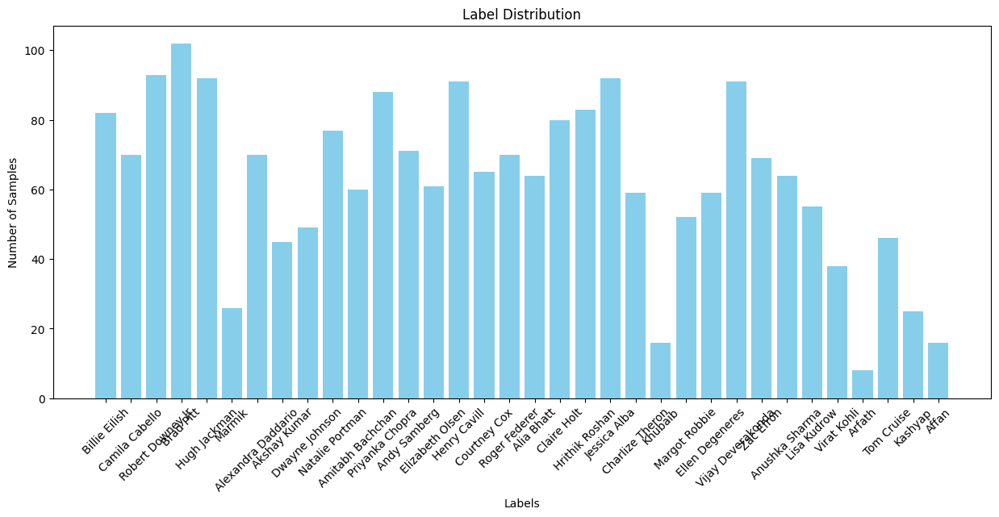

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter
# Count the number of samples for each label
label_counts = Counter(y_train)
# Bar plot of label distribution
plt.figure(figsize=(15, 6))
plt.bar(label_counts.keys(), label_counts.values(), color='skyblue')
plt.title('Label Distribution')
plt.xlabel('Labels')
plt.ylabel('Number of Samples')
plt.xticks(rotation=45)
plt.show()

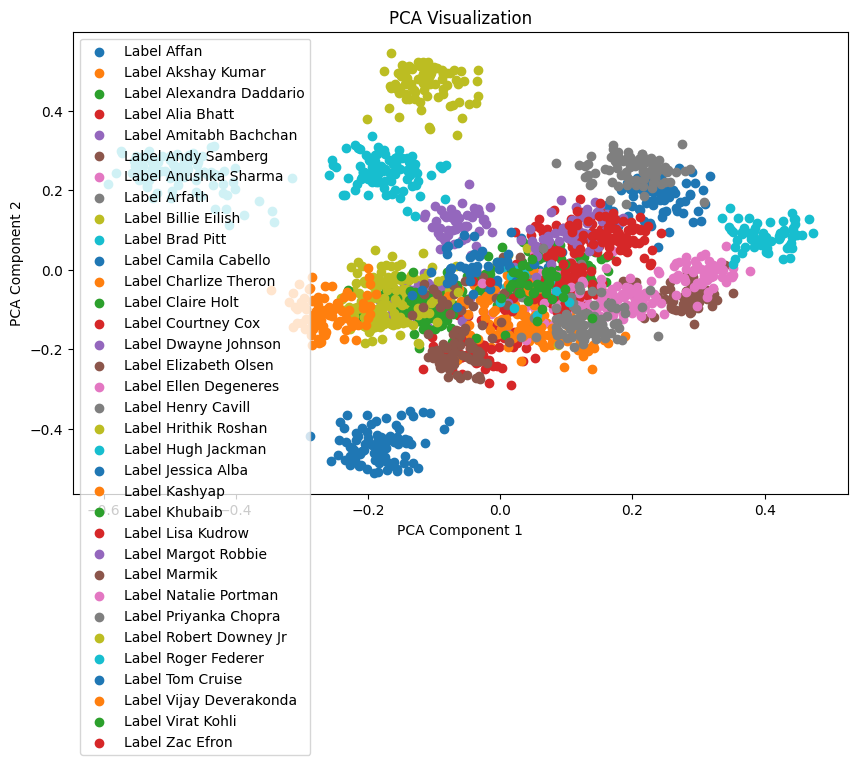

In [ ]:
from sklearn.decomposition import PCA
# Perform PCA to reduce dimensions to 2D
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_train)
# Scatter plot of PCA
plt.figure(figsize=(10, 6))
for label in np.unique(y_train):
    plt.scatter(X_pca[y_train == label, 0], X_pca[y_train == label, 1], label=f'Label {label}')
plt.title('PCA Visualization')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.legend()
plt.show()

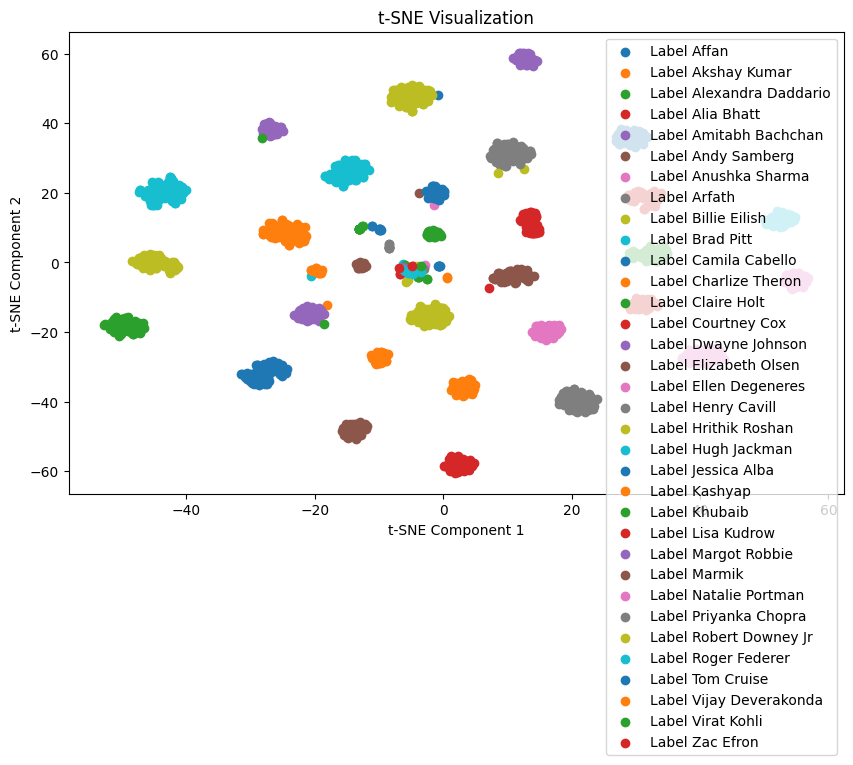

In [ ]:
from sklearn.manifold import TSNE
# Perform t-SNE to reduce dimensions to 2D
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X_train)
# Scatter plot of t-SNE
plt.figure(figsize=(10, 6))
for label in np.unique(y_train):
    plt.scatter(X_tsne[y_train == label, 0], X_tsne[y_train == label, 1], label=f'Label {label}')
plt.title('t-SNE Visualization')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.legend()
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
from sklearn.metrics import confusion_matrix, precision_recall_curve, roc_curve, auc, ConfusionMatrixDisplay
import numpy as np

# Plotting functions
def plot_confusion_matrix(y_true, y_pred, model_name):
    cm = confusion_matrix(y_true, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=np.unique(y_test))

    plt.figure(figsize=(15, 15))  # Adjust the figure size
    disp.plot(cmap=plt.cm.Blues, values_format='d', ax=plt.gca())

    plt.xticks(rotation=90, ha='right')  # Rotate x labels to avoid overlap
    plt.title(f'Confusion Matrix for {model_name}')
    plt.show()

from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_auc_score
from sklearn.multiclass import OneVsRestClassifier

# Binarize the labels for multiclass one-vs-rest
y_test_bin = label_binarize(y_test, classes=np.unique(y_test))

# Plotting functions for One-vs-Rest
def plot_roc_curve_multiclass(y_true, y_scores, model_name, num_classes):
    plt.figure(figsize=(10, 8))  # Increase figure size

    # Adjust how many classes to show at a time if too many exist
    max_classes_to_plot = 10  # Adjust based on preference
    for i in range(min(num_classes, max_classes_to_plot)):  # Plot only a subset
        fpr, tpr, _ = roc_curve(y_true[:, i], y_scores[:, i])
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, label=f'Class {i} (AUC = {roc_auc:.2f})')

    plt.plot([0, 1], [0, 1], linestyle='--')  # Random guess line
    plt.title(f'ROC Curve for {model_name}')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend(loc="lower right", bbox_to_anchor=(1.05, 1))  # Place legend outside
    plt.grid()
    plt.tight_layout()  # Ensure no overlap
    plt.show()

def plot_precision_recall_curve_multiclass(y_true, y_scores, model_name, num_classes):
    plt.figure(figsize=(10, 8))  # Increase figure size

    max_classes_to_plot = 10  # Adjust based on preference
    for i in range(min(num_classes, max_classes_to_plot)):  # Plot only a subset
        precision, recall, _ = precision_recall_curve(y_true[:, i], y_scores[:, i])
        plt.plot(recall, precision, label=f'Class {i}')

    plt.title(f'Precision-Recall Curve for {model_name}')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.legend(loc="lower left", bbox_to_anchor=(1.05, 1))  # Place legend outside
    plt.grid()
    plt.tight_layout()  # Ensure no overlap
    plt.show()


In [ ]:
# Updated evaluate_model_multiclass function
def evaluate_model_multiclass(model_name, X_test, y_test_bin, num_classes):
    with open(f'/content/drive/MyDrive/Colab Notebooks/Face Recognition/models3/{model_name.lower().replace(" ", "_")}_model.pkl', 'rb') as f:
        model = pickle.load(f)

    # Predict class labels
    y_pred = model.predict(X_test)

    # Convert y_pred (strings) to numeric using np.unique to match the binarized y_test_bin
    label_encoder = {label: idx for idx, label in enumerate(np.unique(y_pred))}
    y_pred_numeric = np.array([label_encoder[label] for label in y_pred])

    # Predict probabilities for each class
    y_scores = model.predict_proba(X_test)

    # Confusion Matrix - Use argmax on y_test_bin to get the numeric labels for y_true
    plot_confusion_matrix(y_test_bin.argmax(axis=1), y_pred_numeric, model_name)

    # ROC and Precision-Recall for One-vs-Rest
    plot_roc_curve_multiclass(y_test_bin, y_scores, model_name, num_classes)
    plot_precision_recall_curve_multiclass(y_test_bin, y_scores, model_name, num_classes)



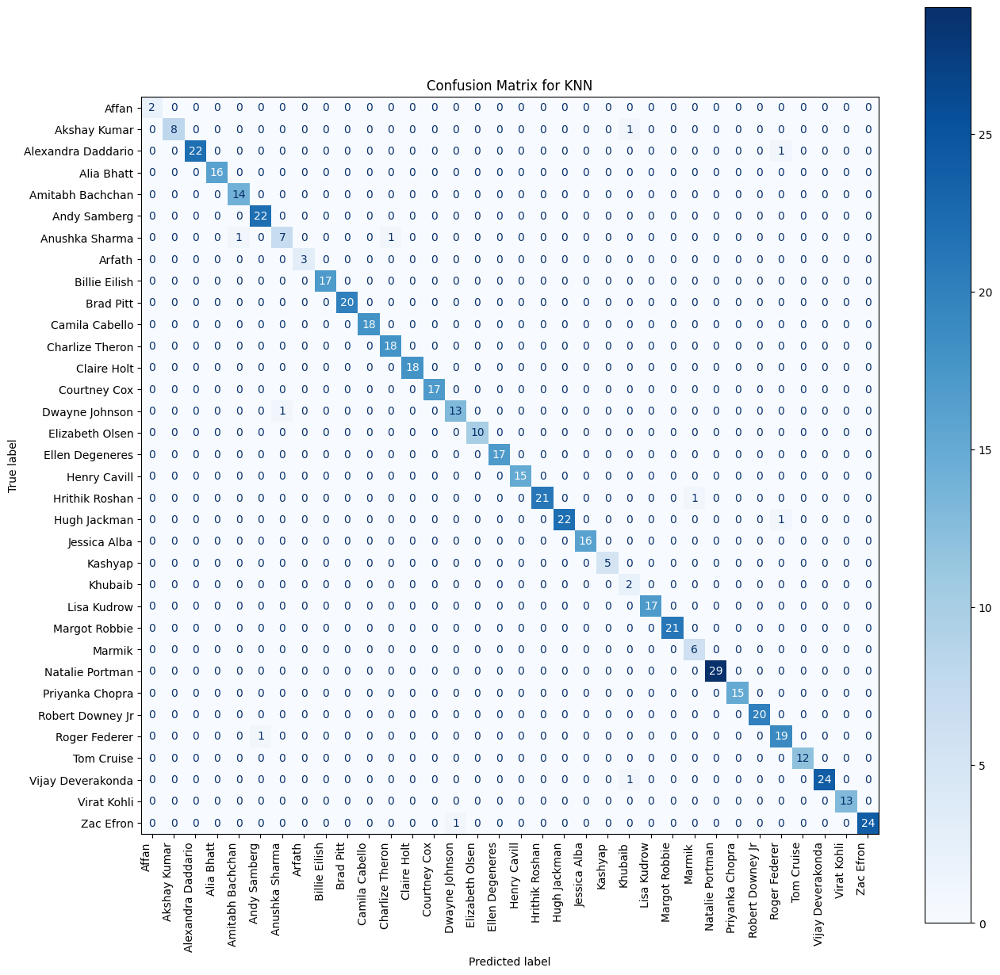

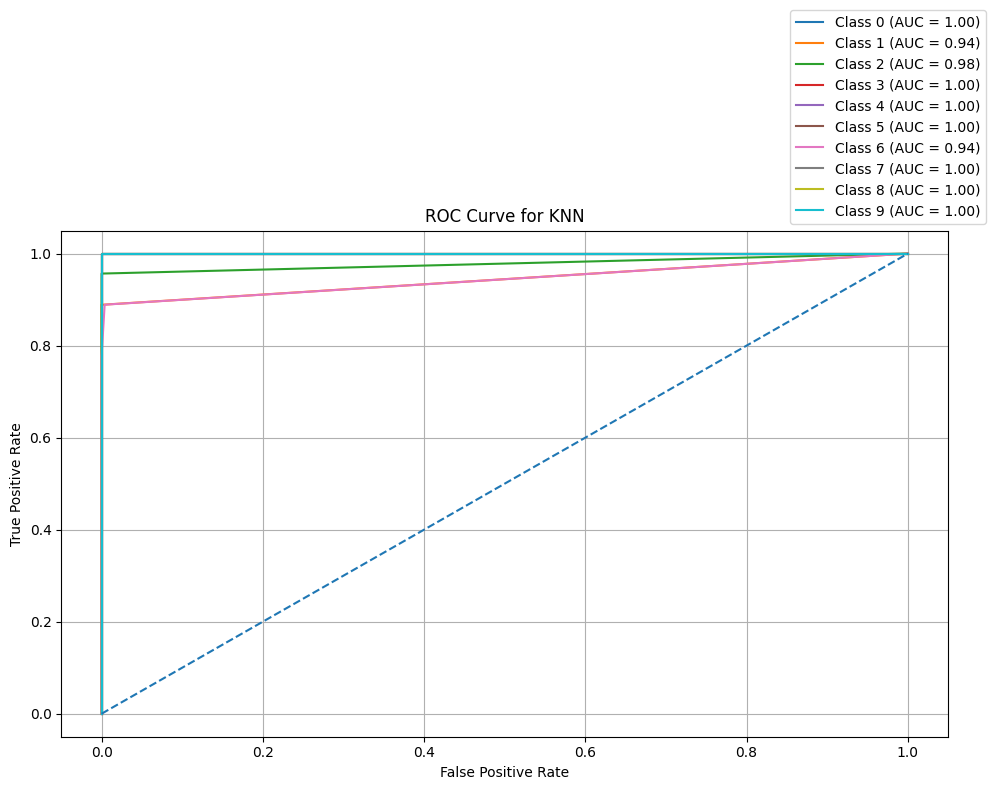

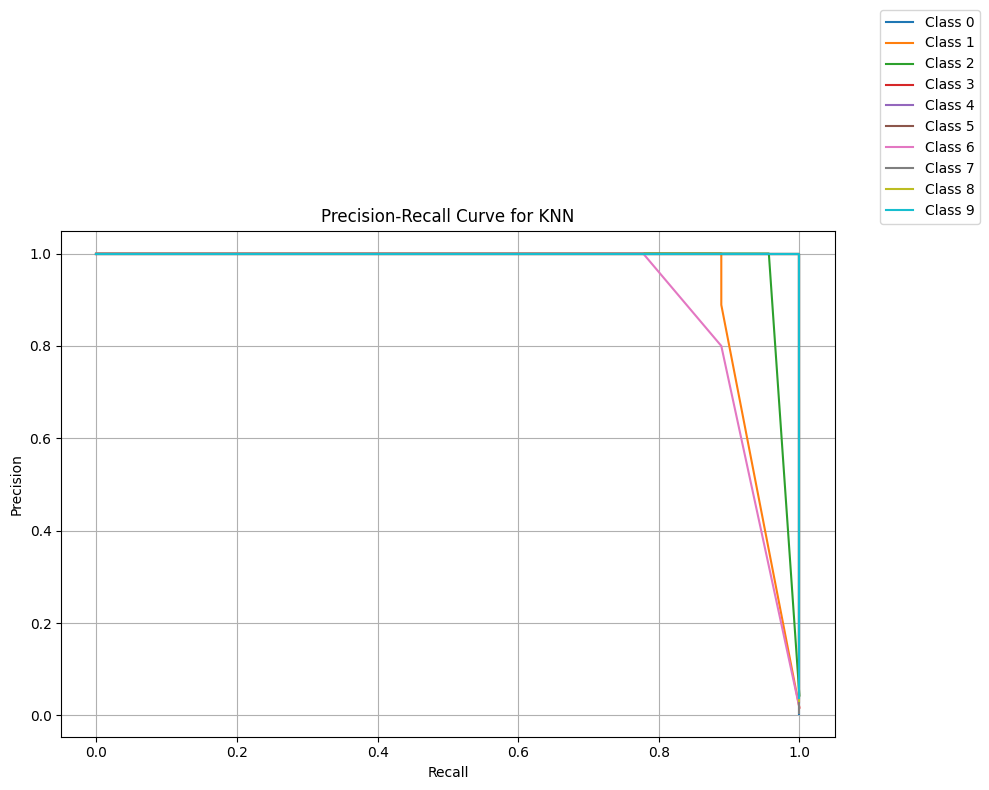

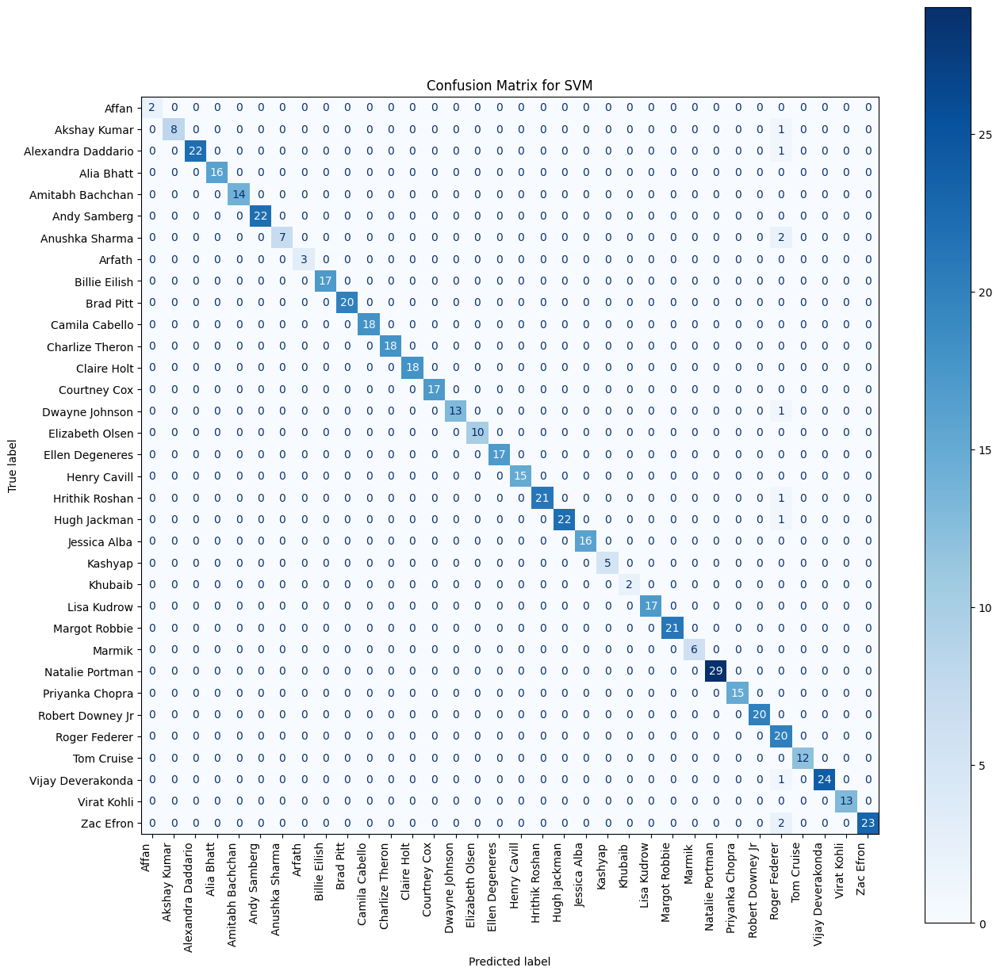

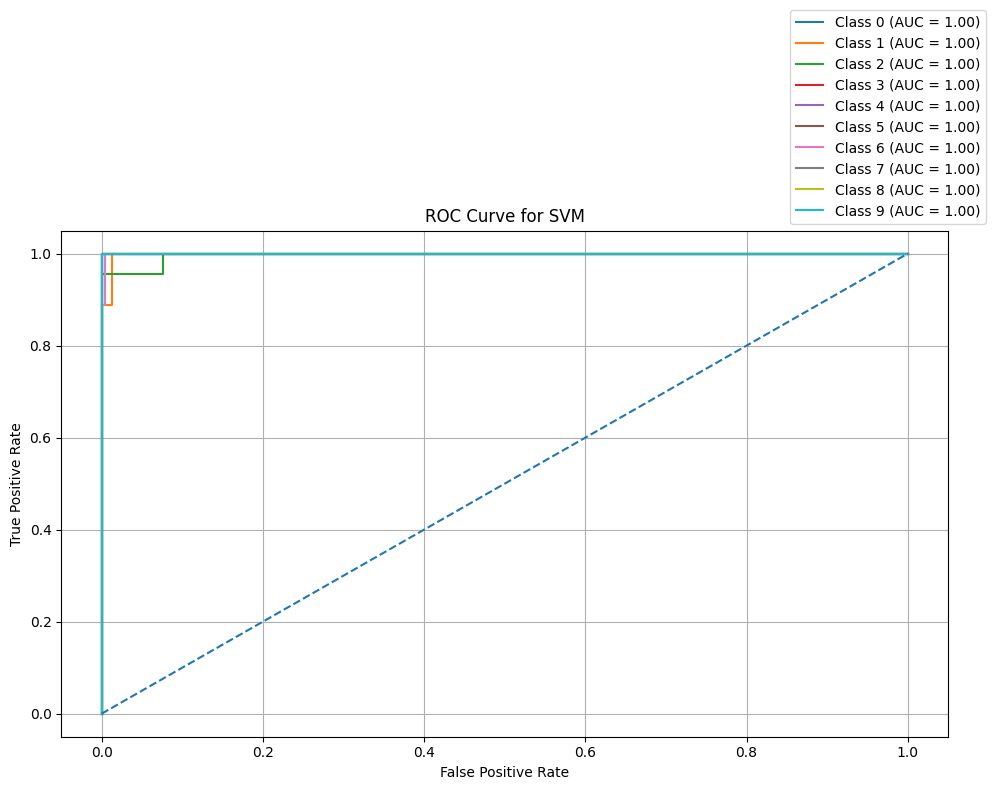

...

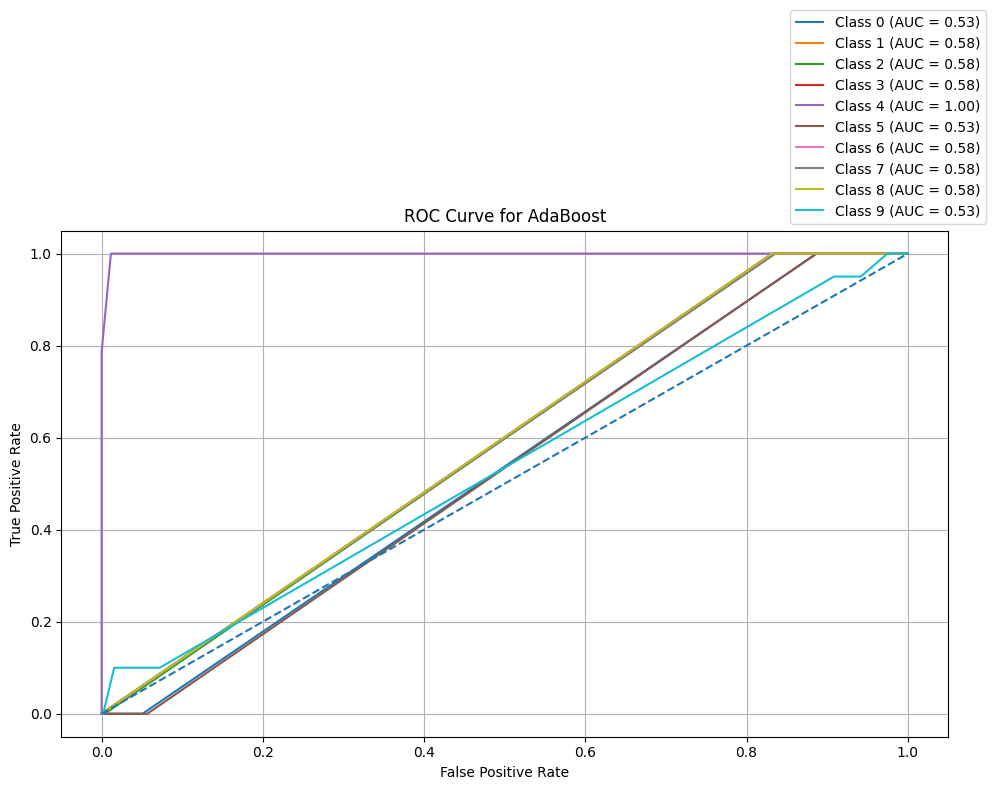

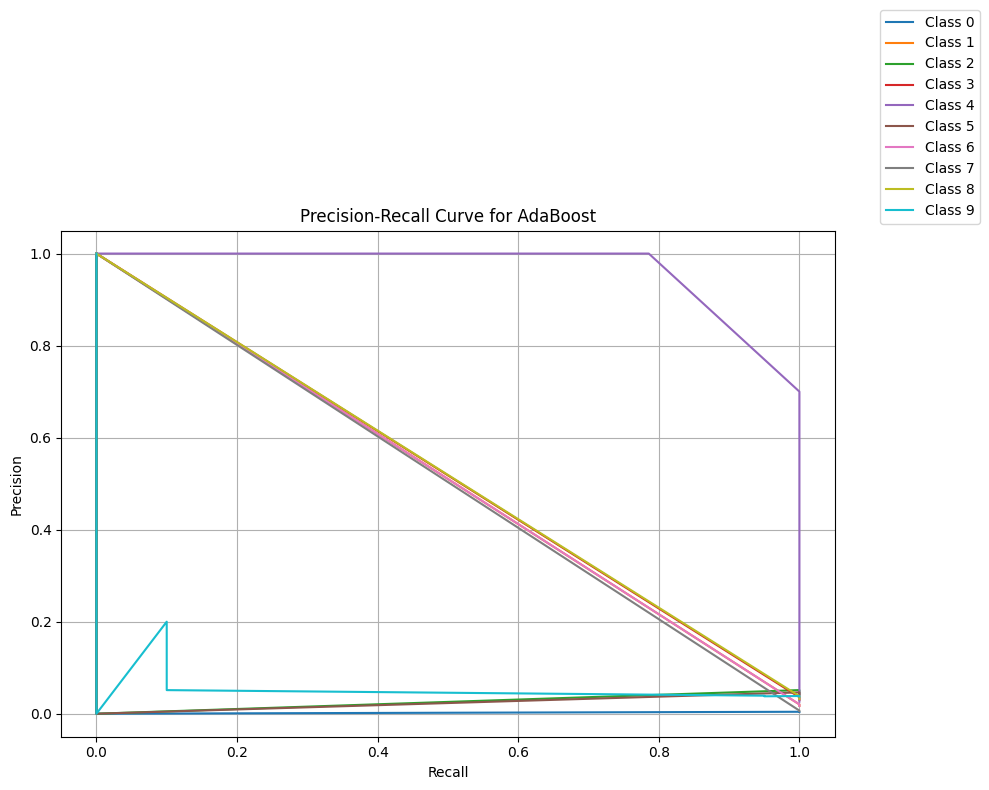

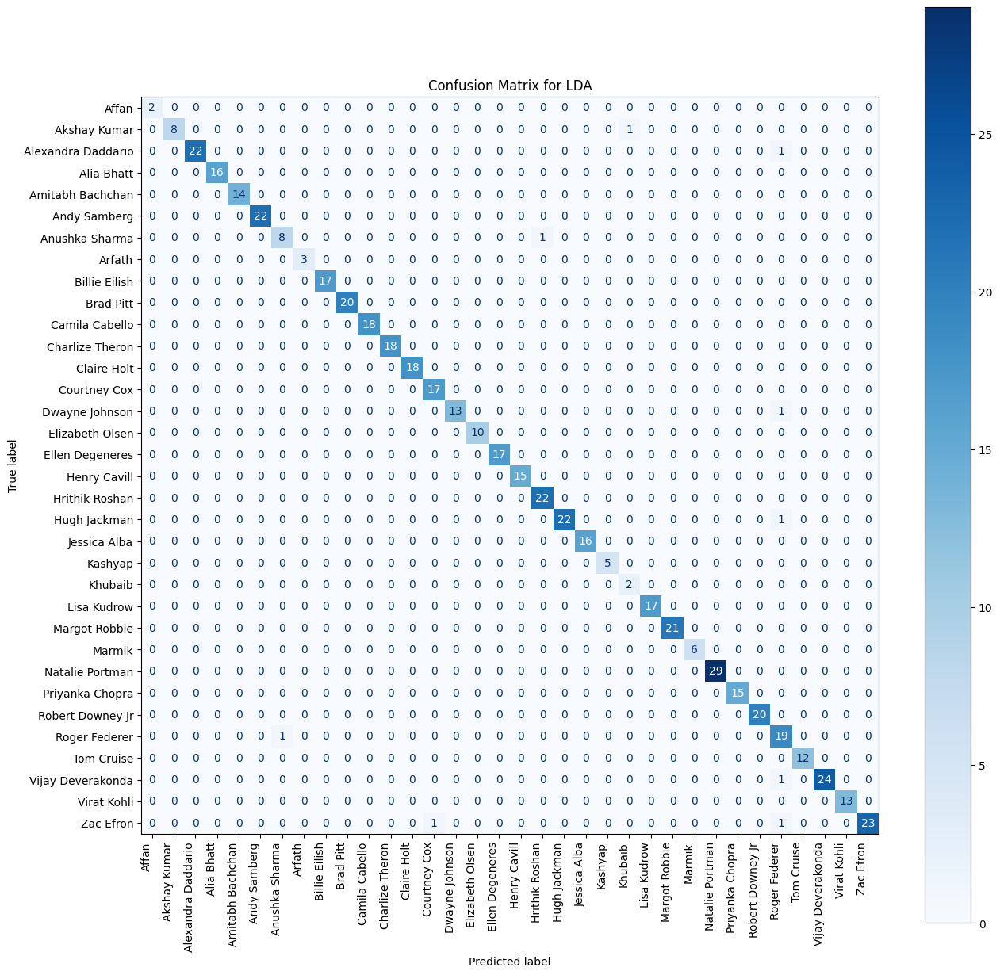

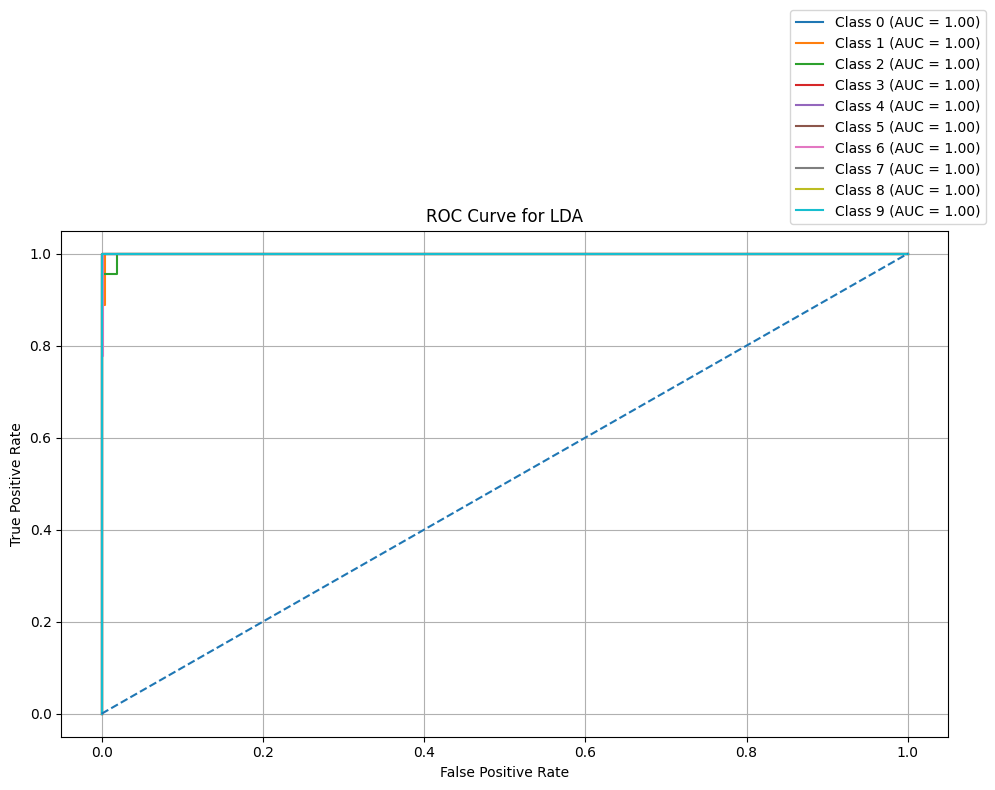

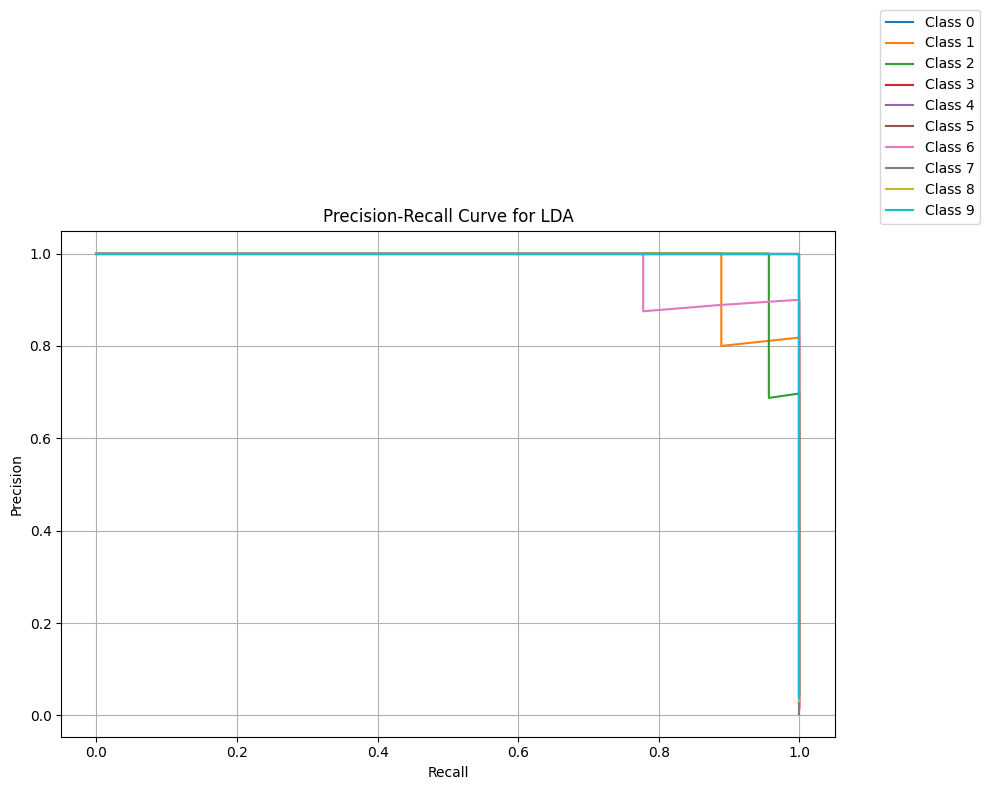

In [ ]:

# Number of unique classes in your dataset
num_classes = len(np.unique(y_test))

# Evaluate each model
for model_name in models.keys():
    evaluate_model_multiclass(model_name, X_test, y_test_bin, num_classes)

In [ ]:
import cv2
import os
import pickle
from imgbeddings import imgbeddings
from PIL import Image
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics.pairwise import euclidean_distances
from google.colab.patches import cv2_imshow  # Import for Colab image display

In [ ]:
# Load the embeddings and labels
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data/face_data.pkl', 'rb') as f:
    face_data = pickle.load(f)
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data/labels.pkl', 'rb') as f:
    labels = pickle.load(f)

In [ ]:
# Load the pre-trained model from the .pkl file
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/knn_model.pkl', 'rb') as f:
    knn_model = pickle.load(f)

with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/svm_model.pkl', 'rb') as f:
    svm_model = pickle.load(f)

with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/lda_model.pkl', 'rb') as f:
    lda_model = pickle.load(f)

with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/mlp_model.pkl', 'rb') as f:
    mlp_model = pickle.load(f)


In [ ]:
ibed = imgbeddings()

# Threshold to determine if a face is "Unknown"
UNKNOWN_DISTANCE_THRESHOLD = 10.0


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_deprecation.py:131: FutureWarning: 'cached_download' (from 'huggingface_hub.file_download') is deprecated and will be removed from version '0.26'. Use `hf_hub_download` instead.
  warnings.warn(warning_message, FutureWarning)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:680: FutureWarning: 'cached_download' is the legacy way to download files from the HF hub, please consider upgrading to 'hf_hub_download'
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public m

patch32_v1.onnx:   0%|          | 0.00/88.2M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/862k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.22M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.19k [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/clip/processing_clip.py:149: FutureWarning: `feature_extractor` is deprecated and will be removed in v5. Use `image_processor` instead.
  warnings.warn(


In [ ]:
from sklearn.svm import OneClassSVM
# Train One-Class SVM model on known embeddings
oc_svm = OneClassSVM(kernel='rbf', gamma='auto', nu=0.01)  # nu sets the sensitivity to outliers
oc_svm.fit(face_data)

# Save the One-Class SVM model
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/ocsvm_model.pkl', 'wb') as f:
    pickle.dump(oc_svm, f)

In [ ]:
# Load One-Class SVM model
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/ocsvm_model.pkl', 'rb') as f:
    ocsvm_model = pickle.load(f)

In [ ]:
# Load all images from a folder sequentially
image_folder = '/content/drive/MyDrive/Colab Notebooks/Face Recognition/test_data'
image_files = [os.path.join(image_folder, f) for f in os.listdir(image_folder) if f.endswith(('.jpg', '.jpeg'))]

In [ ]:
# Initialize YuNet for face detection
yunet = cv2.FaceDetectorYN.create(
    model='/content/drive/MyDrive/Colab Notebooks/Face Recognition/face_detection_yunet_2023mar.onnx',
    config='',
    input_size=(320, 320),
    score_threshold=0.9,  # Adjust this threshold as needed
    nms_threshold=0.3,
    top_k=5000
)

In [ ]:
def resize_with_aspect_ratio(image, max_width=800, max_height=600):
    """Resizes the image maintaining aspect ratio to fit within the specified bounds."""
    h, w = image.shape[:2]

    # Calculate the scaling factor for width and height
    scaling_factor_w = max_width / w
    scaling_factor_h = max_height / h

    # Choose the smaller scaling factor to maintain aspect ratio
    scaling_factor = min(scaling_factor_w, scaling_factor_h)

    # If image is already smaller, no need to resize
    if scaling_factor >= 1:
        return image

    # Resize the image using the scaling factor
    new_width = int(w * scaling_factor)
    new_height = int(h * scaling_factor)

    return cv2.resize(image, (new_width, new_height))

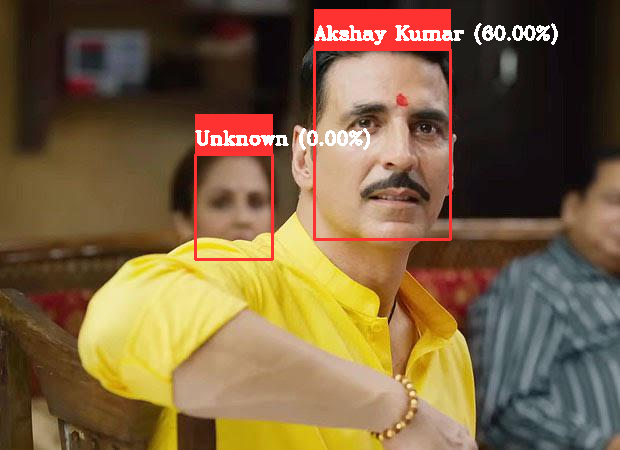

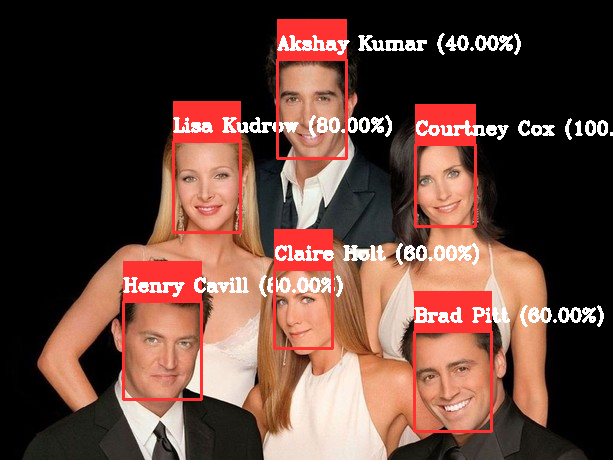

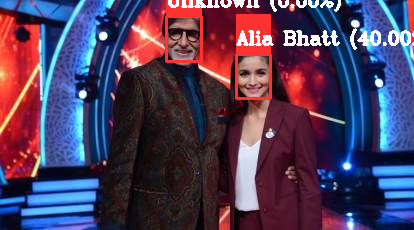

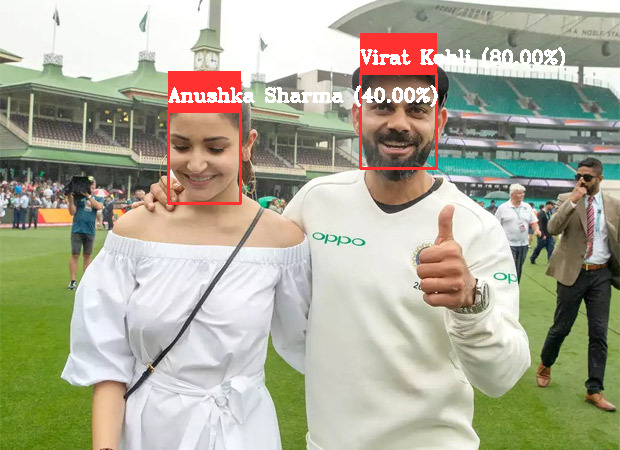

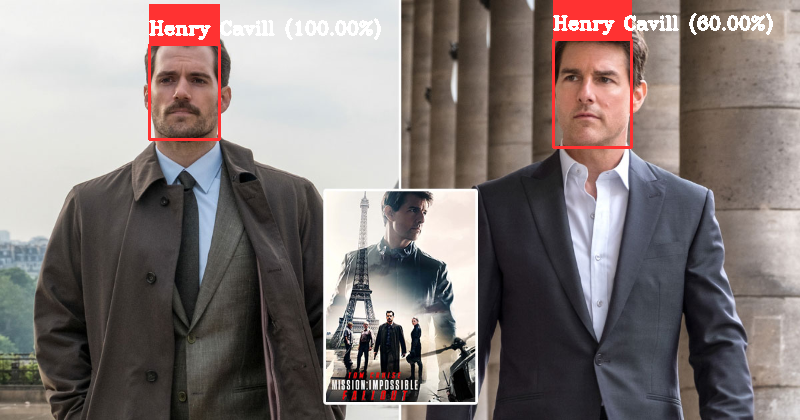

...

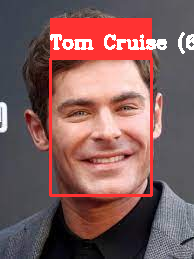

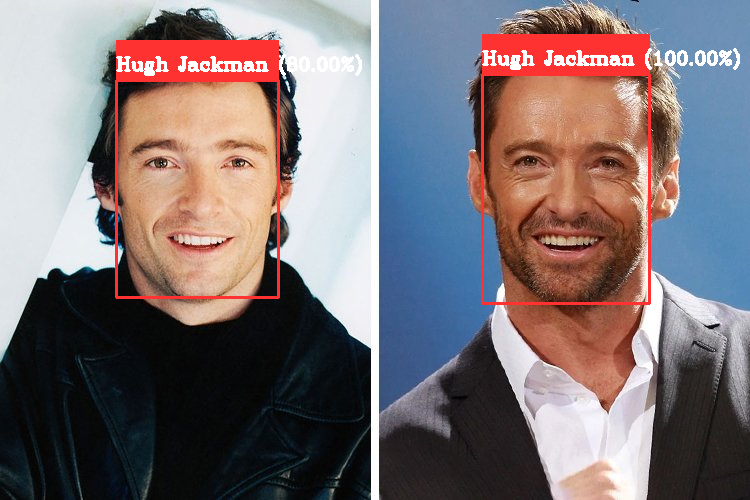

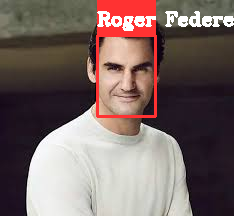

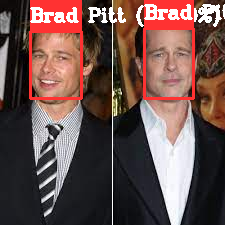

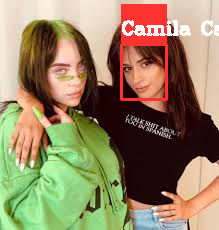

In [ ]:
for img_path in image_files:
    frame = cv2.imread(img_path)

    if frame is None:
        print(f"Error: Could not read image {img_path}.")
        continue

    # Resize image to fit in window without cropping, keeping aspect ratio
    frame_resized = resize_with_aspect_ratio(frame)

    # Get the dimensions of the resized frame (image)
    frame_height, frame_width, _ = frame_resized.shape

    yunet.setInputSize((frame_width, frame_height))

    # Detect faces using YuNet
    faces = yunet.detect(frame_resized)

    if faces[1] is not None:  # Check if any faces were detected
        for face in faces[1]:
            # face contains [x, y, w, h, score, landmarks...]
            x, y, w, h = face[:4].astype(int)

            crop_img = frame_resized[y:y+h, x:x+w, :]
            resized_img = cv2.resize(crop_img, (50, 50))
            img_pil = Image.fromarray(cv2.cvtColor(resized_img, cv2.COLOR_BGR2RGB))
            embedding = ibed.to_embeddings(img_pil).reshape(1, -1)

            # Find the closest distance to existing embeddings
            distances = euclidean_distances(embedding, face_data)
            min_distance = distances.min()

            # Predict using KNN and get the match percentage
            predicted_name = knn_model.predict(embedding)[0]
            match_prob = knn_model.predict_proba(embedding).max() * 100  # Get the highest probability

            # Check if embedding is an outlier using One-Class SVM
            ocsvm_prediction = ocsvm_model.predict(embedding)

            if ocsvm_prediction == -1:
                # Outlier detected, mark as "Unknown"
                predicted_name = "Unknown"
                match_prob = 0.0  # No match percentage for unknown faces
            else:
                # Predict using KNN and get match percentage
                predicted_name = knn_model.predict(embedding)[0]
                match_prob = knn_model.predict_proba(embedding).max() * 100  # Get the highest probability

            # Draw the rectangle and display the prediction
            cv2.rectangle(frame_resized, (x, y), (x + w, y + h), (0, 0, 255), 1)
            cv2.rectangle(frame_resized, (x, y), (x + w, y + h), (50, 50, 255), 2)
            cv2.rectangle(frame_resized, (x, y - 40), (x + w, y), (50, 50, 255), -1)
            cv2.putText(frame_resized, f"{predicted_name} ({match_prob:.2f}%)", (x, y - 10), cv2.FONT_HERSHEY_COMPLEX, 0.6, (255, 255, 255), 2)

    # Display the resized image with detection using cv2_imshow for Colab
    cv2_imshow(frame_resized)

    k = cv2.waitKey(0)  # Wait for a key press before moving to the next image
    if k == ord('q'):
        break

cv2.destroyAllWindows()

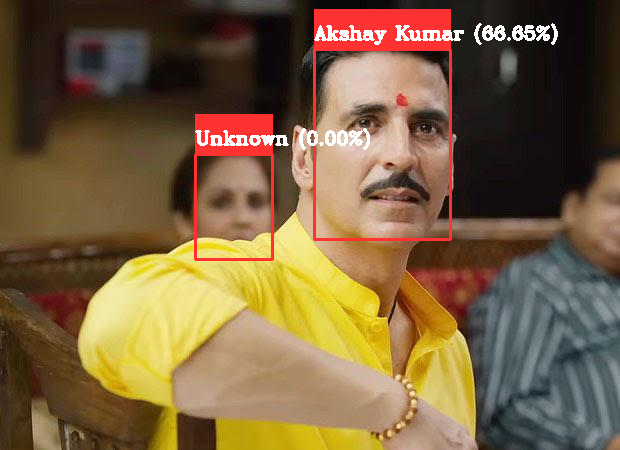

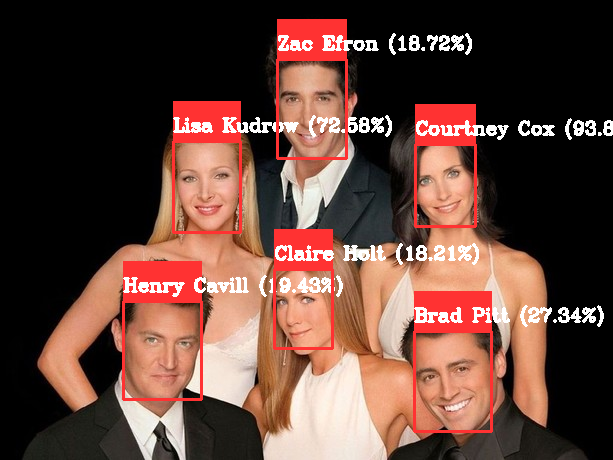

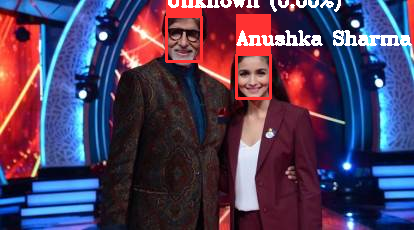

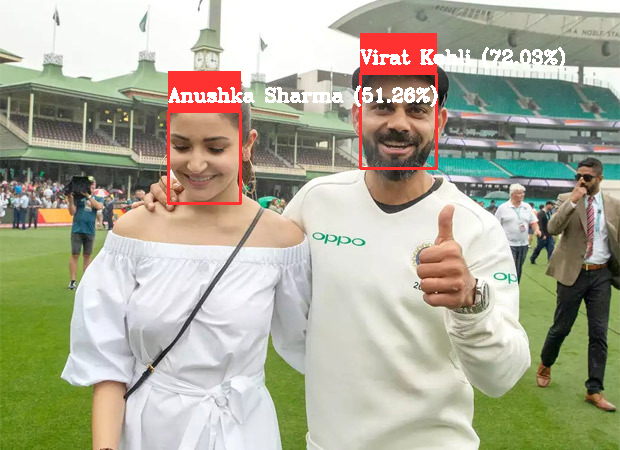

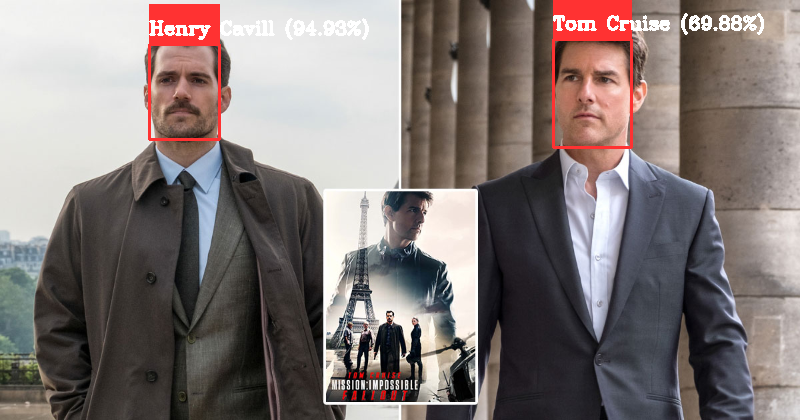

...

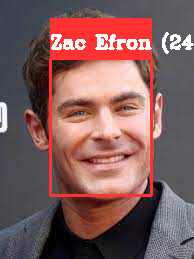

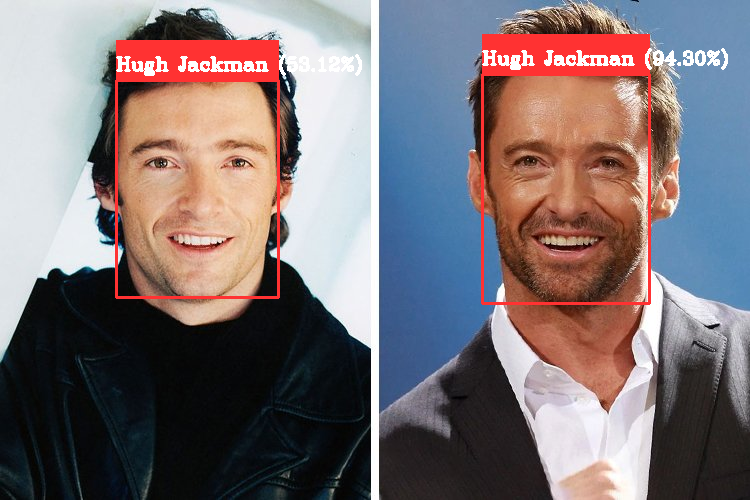

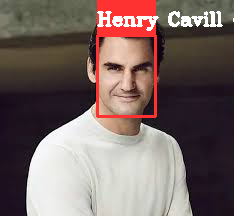

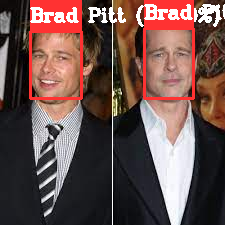

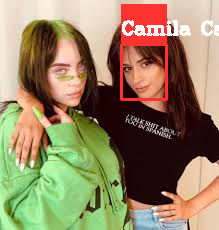

In [ ]:
for img_path in image_files:
    frame = cv2.imread(img_path)

    if frame is None:
        print(f"Error: Could not read image {img_path}.")
        continue

    # Resize image to fit in window without cropping, keeping aspect ratio
    frame_resized = resize_with_aspect_ratio(frame)

    # Get the dimensions of the resized frame (image)
    frame_height, frame_width, _ = frame_resized.shape

    yunet.setInputSize((frame_width, frame_height))

    # Detect faces using YuNet
    faces = yunet.detect(frame_resized)

    if faces[1] is not None:  # Check if any faces were detected
        for face in faces[1]:
            # face contains [x, y, w, h, score, landmarks...]
            x, y, w, h = face[:4].astype(int)

            crop_img = frame_resized[y:y+h, x:x+w, :]
            resized_img = cv2.resize(crop_img, (50, 50))
            img_pil = Image.fromarray(cv2.cvtColor(resized_img, cv2.COLOR_BGR2RGB))
            embedding = ibed.to_embeddings(img_pil).reshape(1, -1)

            # Find the closest distance to existing embeddings
            distances = euclidean_distances(embedding, face_data)
            min_distance = distances.min()

            # Predict using SVM and get the match percentage
            predicted_name = svm_model.predict(embedding)[0]
            match_prob = svm_model.predict_proba(embedding).max() * 100  # Get the highest probability

            # Check if embedding is an outlier using One-Class SVM
            ocsvm_prediction = ocsvm_model.predict(embedding)

            if ocsvm_prediction == -1:
                # Outlier detected, mark as "Unknown"
                predicted_name = "Unknown"
                match_prob = 0.0  # No match percentage for unknown faces
            else:
                # Predict using SVM and get match percentage
                predicted_name = svm_model.predict(embedding)[0]
                match_prob = svm_model.predict_proba(embedding).max() * 100  # Get the highest probability

            # Draw the rectangle and display the prediction
            cv2.rectangle(frame_resized, (x, y), (x + w, y + h), (0, 0, 255), 1)
            cv2.rectangle(frame_resized, (x, y), (x + w, y + h), (50, 50, 255), 2)
            cv2.rectangle(frame_resized, (x, y - 40), (x + w, y), (50, 50, 255), -1)
            cv2.putText(frame_resized, f"{predicted_name} ({match_prob:.2f}%)", (x, y - 10), cv2.FONT_HERSHEY_COMPLEX, 0.6, (255, 255, 255), 2)

    # Display the resized image with detection using cv2_imshow for Colab
    cv2_imshow(frame_resized)

    k = cv2.waitKey(0)  # Wait for a key press before moving to the next image
    if k == ord('q'):
        break

cv2.destroyAllWindows()

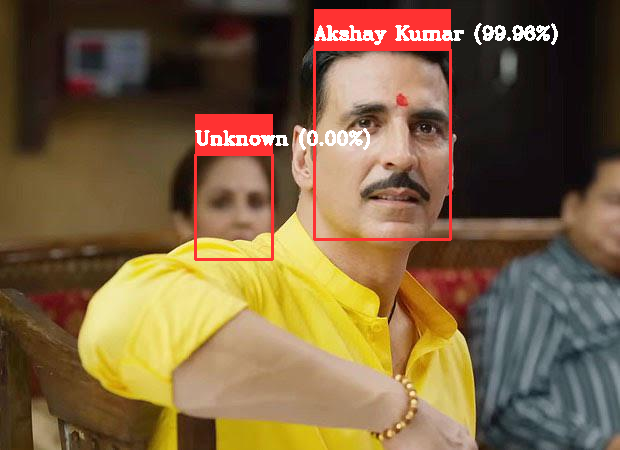

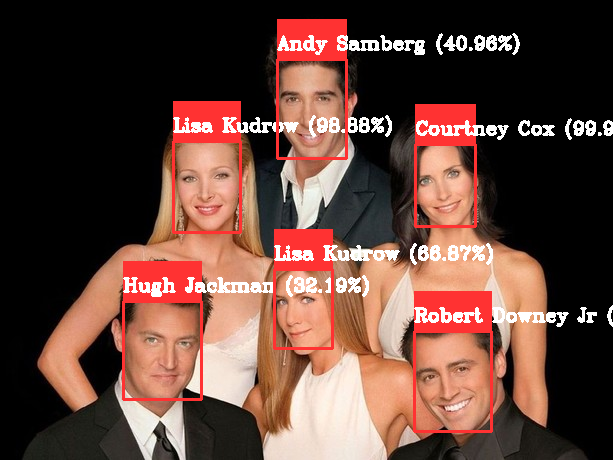

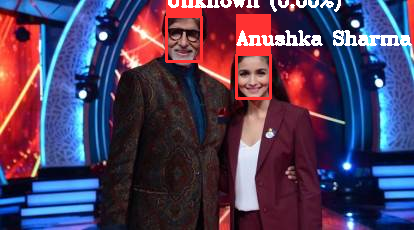

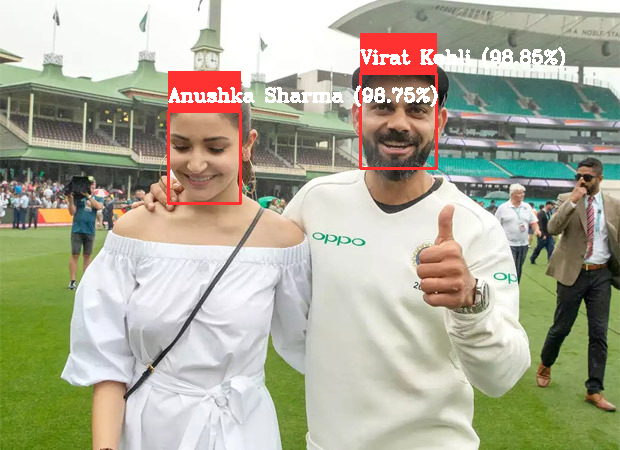

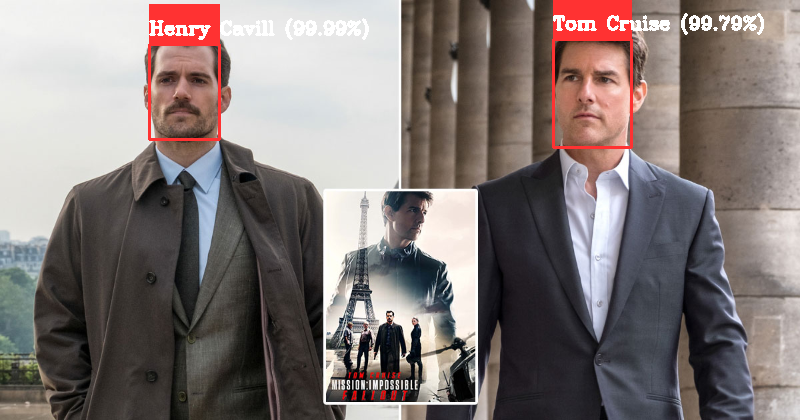

...

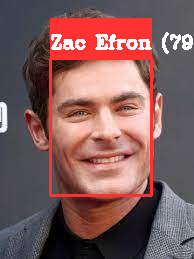

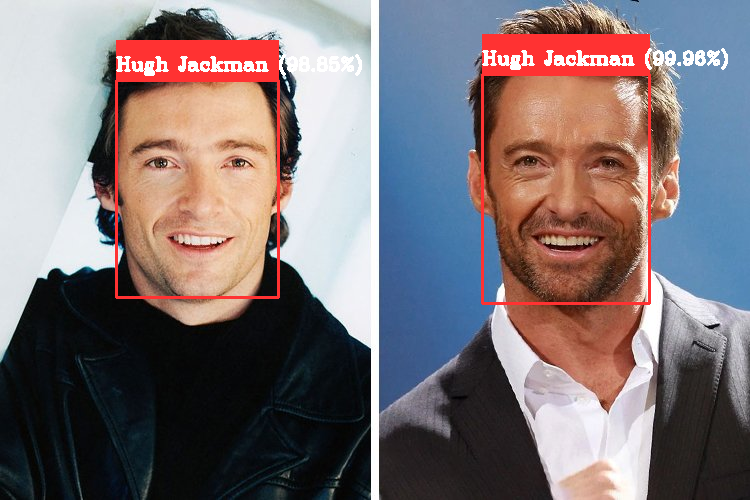

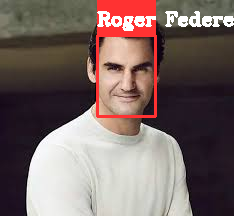

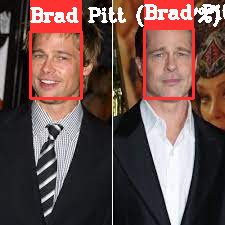

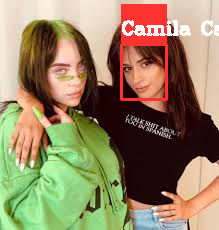

In [ ]:
for img_path in image_files:
    frame = cv2.imread(img_path)

    if frame is None:
        print(f"Error: Could not read image {img_path}.")
        continue

    # Resize image to fit in window without cropping, keeping aspect ratio
    frame_resized = resize_with_aspect_ratio(frame)

    # Get the dimensions of the resized frame (image)
    frame_height, frame_width, _ = frame_resized.shape

    yunet.setInputSize((frame_width, frame_height))

    # Detect faces using YuNet
    faces = yunet.detect(frame_resized)

    if faces[1] is not None:  # Check if any faces were detected
        for face in faces[1]:
            # face contains [x, y, w, h, score, landmarks...]
            x, y, w, h = face[:4].astype(int)

            crop_img = frame_resized[y:y+h, x:x+w, :]
            resized_img = cv2.resize(crop_img, (50, 50))
            img_pil = Image.fromarray(cv2.cvtColor(resized_img, cv2.COLOR_BGR2RGB))
            embedding = ibed.to_embeddings(img_pil).reshape(1, -1)

            # Find the closest distance to existing embeddings
            distances = euclidean_distances(embedding, face_data)
            min_distance = distances.min()

            # Predict using MLP and get the match percentage
            predicted_name = mlp_model.predict(embedding)[0]
            match_prob = mlp_model.predict_proba(embedding).max() * 100  # Get the highest probability

            # Check if embedding is an outlier using One-Class SVM
            ocsvm_prediction = ocsvm_model.predict(embedding)

            if ocsvm_prediction == -1:
                # Outlier detected, mark as "Unknown"
                predicted_name = "Unknown"
                match_prob = 0.0  # No match percentage for unknown faces
            else:
                # Predict using MLP and get match percentage
                predicted_name = mlp_model.predict(embedding)[0]
                match_prob = mlp_model.predict_proba(embedding).max() * 100  # Get the highest probability

            # Draw the rectangle and display the prediction
            cv2.rectangle(frame_resized, (x, y), (x + w, y + h), (0, 0, 255), 1)
            cv2.rectangle(frame_resized, (x, y), (x + w, y + h), (50, 50, 255), 2)
            cv2.rectangle(frame_resized, (x, y - 40), (x + w, y), (50, 50, 255), -1)
            cv2.putText(frame_resized, f"{predicted_name} ({match_prob:.2f}%)", (x, y - 10), cv2.FONT_HERSHEY_COMPLEX, 0.6, (255, 255, 255), 2)

    # Display the resized image with detection using cv2_imshow for Colab
    cv2_imshow(frame_resized)

    k = cv2.waitKey(0)  # Wait for a key press before moving to the next image
    if k == ord('q'):
        break

cv2.destroyAllWindows()

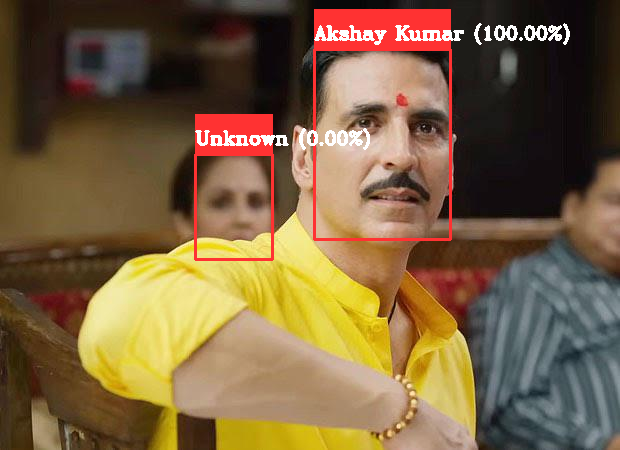

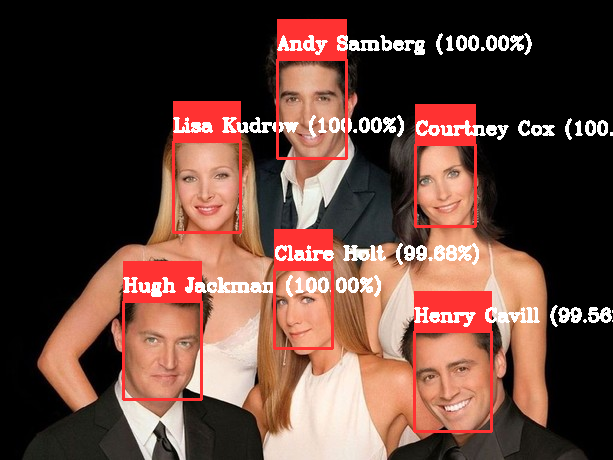

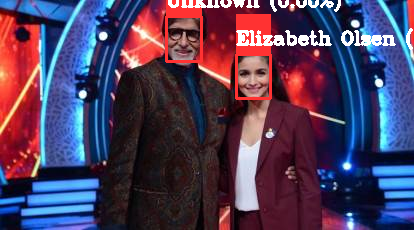

In [ ]:
for img_path in image_files:
    frame = cv2.imread(img_path)

    if frame is None:
        print(f"Error: Could not read image {img_path}.")
        continue

    # Resize image to fit in window without cropping, keeping aspect ratio
    frame_resized = resize_with_aspect_ratio(frame)

    # Get the dimensions of the resized frame (image)
    frame_height, frame_width, _ = frame_resized.shape

    yunet.setInputSize((frame_width, frame_height))

    # Detect faces using YuNet
    faces = yunet.detect(frame_resized)

    if faces[1] is not None:  # Check if any faces were detected
        for face in faces[1]:
            # face contains [x, y, w, h, score, landmarks...]
            x, y, w, h = face[:4].astype(int)

            crop_img = frame_resized[y:y+h, x:x+w, :]
            resized_img = cv2.resize(crop_img, (50, 50))
            img_pil = Image.fromarray(cv2.cvtColor(resized_img, cv2.COLOR_BGR2RGB))
            embedding = ibed.to_embeddings(img_pil).reshape(1, -1)

            # Find the closest distance to existing embeddings
            distances = euclidean_distances(embedding, face_data)
            min_distance = distances.min()

            # Predict using LDA and get the match percentage
            predicted_name = lda_model.predict(embedding)[0]
            match_prob = lda_model.predict_proba(embedding).max() * 100  # Get the highest probability

            # Check if embedding is an outlier using One-Class SVM
            ocsvm_prediction = ocsvm_model.predict(embedding)

            if ocsvm_prediction == -1:
                # Outlier detected, mark as "Unknown"
                predicted_name = "Unknown"
                match_prob = 0.0  # No match percentage for unknown faces
            else:
                # Predict using LDA and get match percentage
                predicted_name = lda_model.predict(embedding)[0]
                match_prob = lda_model.predict_proba(embedding).max() * 100  # Get the highest probability

            # Draw the rectangle and display the prediction
            cv2.rectangle(frame_resized, (x, y), (x + w, y + h), (0, 0, 255), 1)
            cv2.rectangle(frame_resized, (x, y), (x + w, y + h), (50, 50, 255), 2)
            cv2.rectangle(frame_resized, (x, y - 40), (x + w, y), (50, 50, 255), -1)
            cv2.putText(frame_resized, f"{predicted_name} ({match_prob:.2f}%)", (x, y - 10), cv2.FONT_HERSHEY_COMPLEX, 0.6, (255, 255, 255), 2)

    # Display the resized image with detection using cv2_imshow for Colab
    cv2_imshow(frame_resized)

    k = cv2.waitKey(0)  # Wait for a key press before moving to the next image
    if k == ord('q'):
        break

cv2.destroyAllWindows()

In [ ]:
!pip install insightface onnxruntime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 439.5/439.5 kB 22.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.2/13.2 MB 105.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.9/15.9 MB 92.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 8.2 MB/s eta 0:00:00
  Created wheel for insightface: filename=insightface-0.7.3-cp310-cp310-linux_x86_64.whl size=1055396 sha256=c2c6facfa71324a215441bb842e9c7c4baedfa3267a6b02b428c33f31707bcb8
  Stored in directory: /root/.cache/pip/wheels/e3/d0/80/e3773fb8b6d1cca87ea1d33d9b1f20a223a6493c896da249b5
Successfully built insightface


In [ ]:
# Load the embeddings and labels
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/face_data.pkl', 'rb') as f:
    face_data = pickle.load(f)
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/labels.pkl', 'rb') as f:
    labels = pickle.load(f)


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:376: InconsistentVersionWarning: Trying to unpickle estimator OneClassSVM from version 1.3.2 when using version 1.5.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/onnxruntime/capi/onnxruntime_inference_collection.py:69: UserWarning: Specified provider 'CUDAExecutionProvider' is not in available provider names.Available providers: 'AzureExecutionProvider, CPUExecutionProvider'
  warnings.warn(


Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/1k3d68.onnx landmark_3d_68 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/2d106det.onnx landmark_2d_106 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/det_10g.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/genderage.onnx genderage ['None', 3, 96, 96] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/w600k_r50.onnx recognition ['None', 3, 112, 112] 127.5 127.5
set det-size: (640, 640)


/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


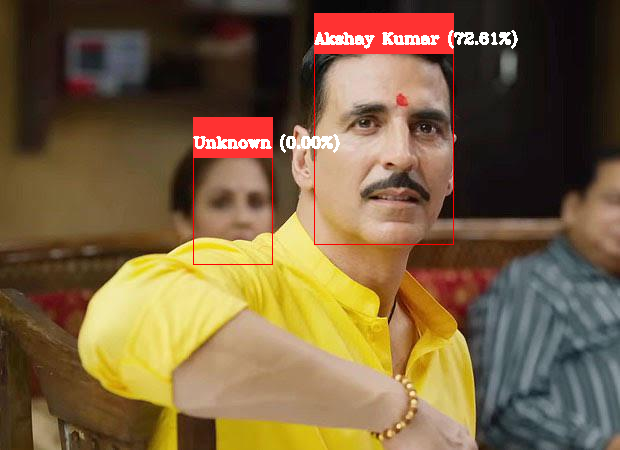

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


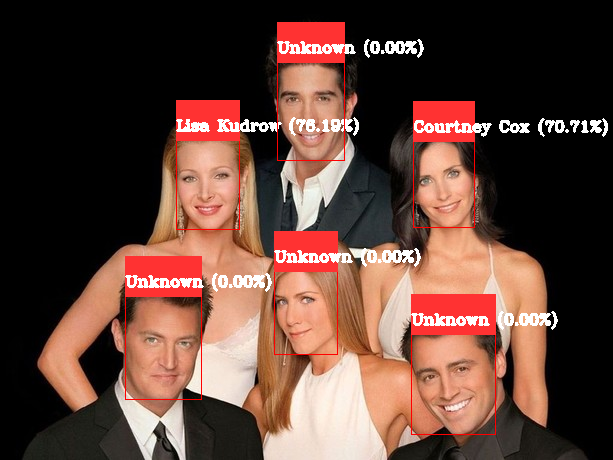

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


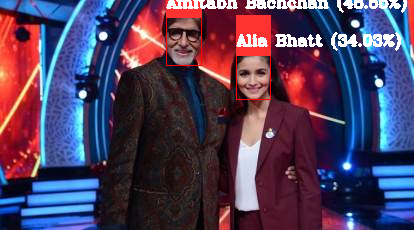

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


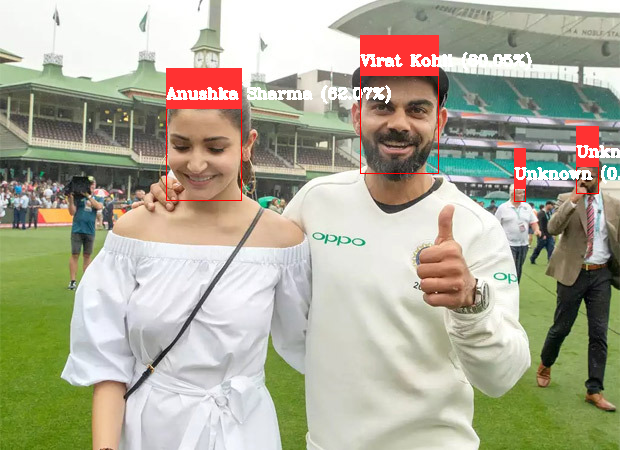

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


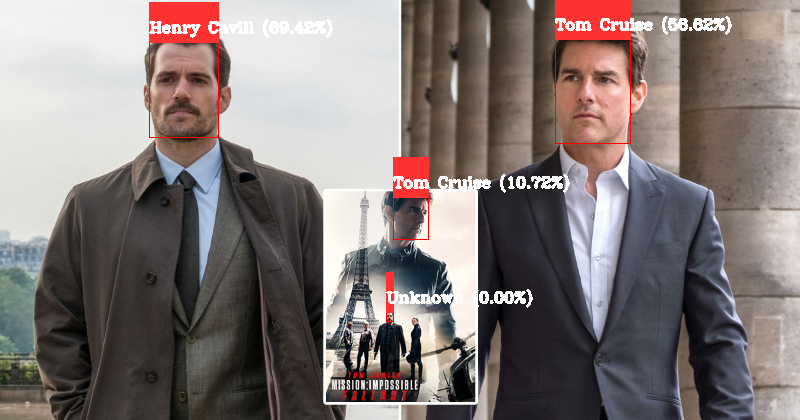

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


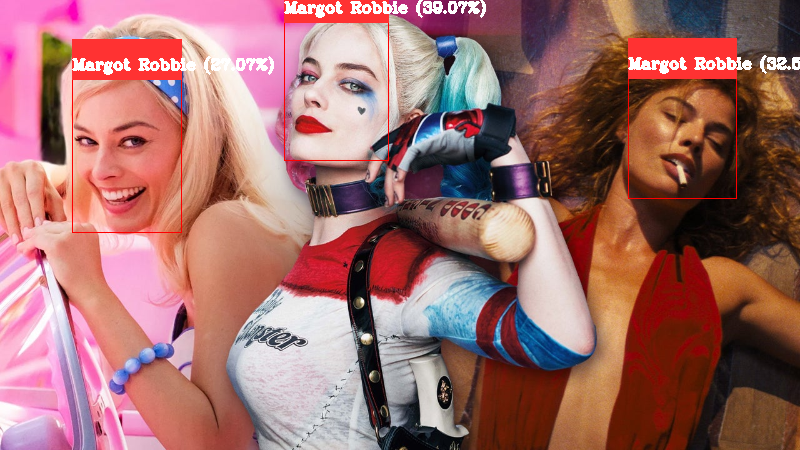

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


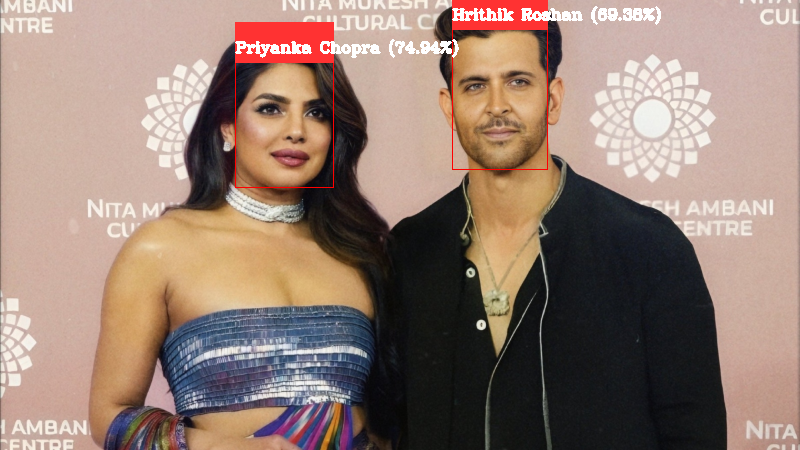

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


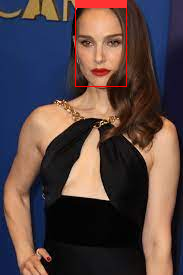

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


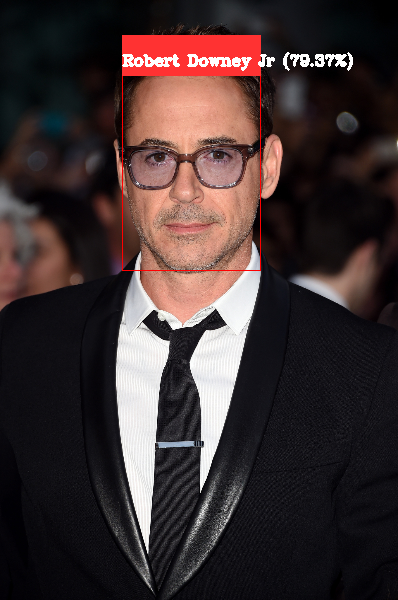

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


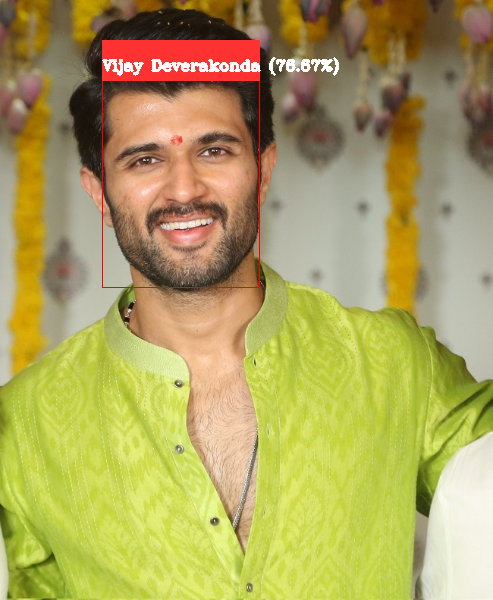

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


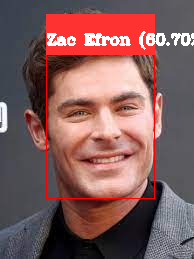

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


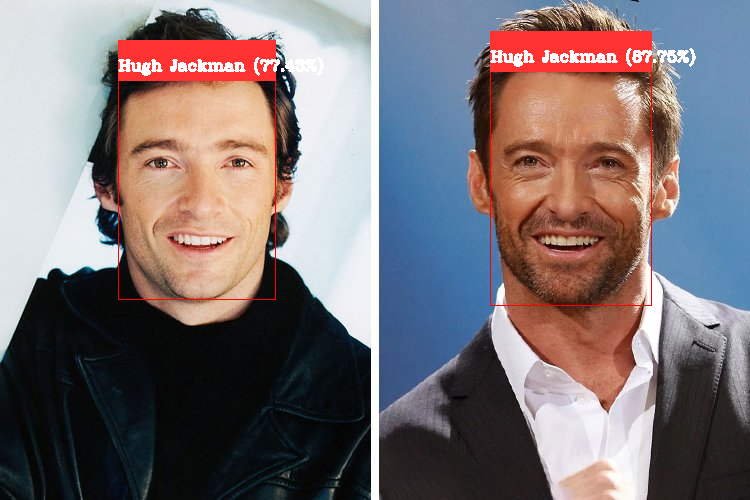

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


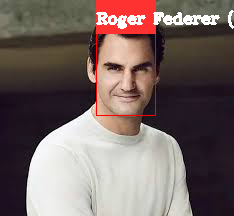

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


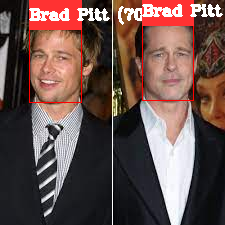

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


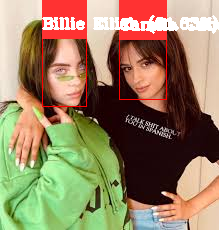

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


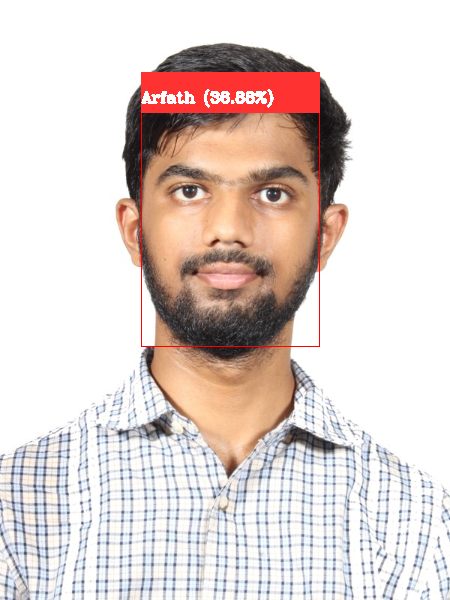

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


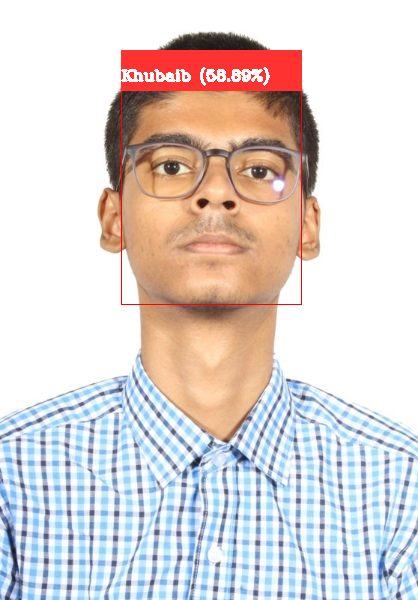

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


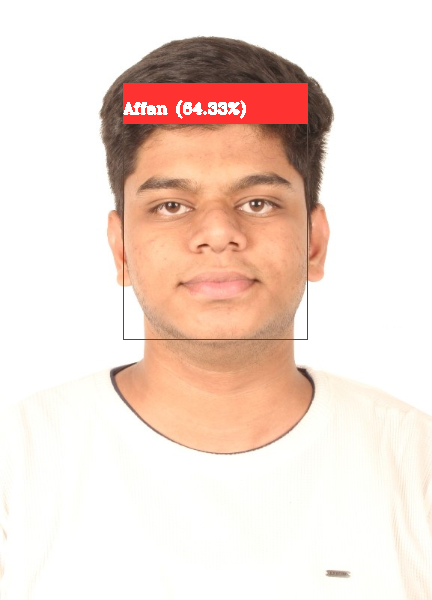

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


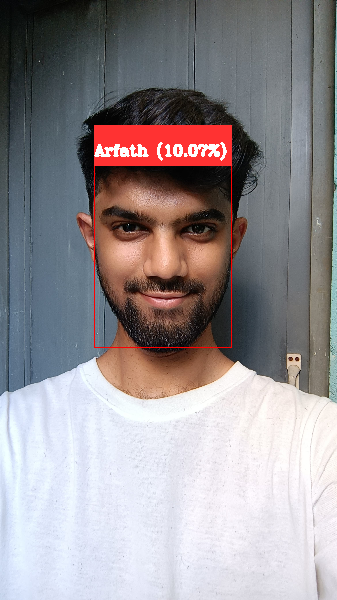

/usr/local/lib/python3.10/dist-packages/insightface/utils/transform.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  P = np.linalg.lstsq(X_homo, Y)[0].T # Affine matrix. 3 x 4


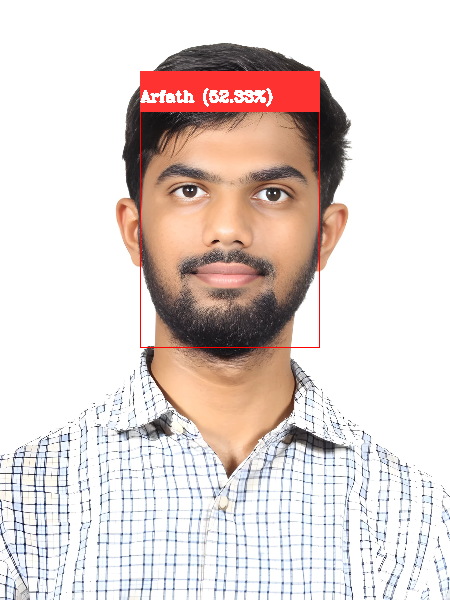

In [ ]:
import cv2
import numpy as np
import os
import pickle
import insightface
from insightface.app import FaceAnalysis
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.svm import OneClassSVM
from google.colab.patches import cv2_imshow  # For Colab image display

# Define the dataset directory
image_folder = '/content/drive/MyDrive/Colab Notebooks/Face Recognition/test_data'
image_files = [os.path.join(image_folder, f) for f in os.listdir(image_folder) if f.endswith(('.jpg', '.jpeg'))]

# Load the embeddings and labels
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/face_data.pkl', 'rb') as f:
    face_data = pickle.load(f)
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/labels.pkl', 'rb') as f:
    labels = pickle.load(f)

# Load the pre-trained models (KNN, SVM, LDA, MLP)
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/models3/svm_model.pkl', 'rb') as f:
    svm_model = pickle.load(f)

# Load One-Class SVM model
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/ocsvm_model.pkl', 'rb') as f:
    ocsvm_model = pickle.load(f)

# Initialize ArcFace model using InsightFace
def load_arcface_model():
    app = FaceAnalysis(providers=['CUDAExecutionProvider', 'CPUExecutionProvider'])  # Use GPU if available
    app.prepare(ctx_id=0, det_size=(640, 640))  # Prepare the face detection and embedding model
    return app

arcface_model = load_arcface_model()

# Resize function to maintain aspect ratio
def resize_with_aspect_ratio(image, max_width=800, max_height=600):
    h, w = image.shape[:2]
    scaling_factor_w = max_width / w
    scaling_factor_h = max_height / h
    scaling_factor = min(scaling_factor_w, scaling_factor_h)

    if scaling_factor >= 1:
        return image

    new_width = int(w * scaling_factor)
    new_height = int(h * scaling_factor)
    return cv2.resize(image, (new_width, new_height))

# Threshold to determine if a face is "Unknown"
UNKNOWN_DISTANCE_THRESHOLD = 1.0

# Process each image in the test folder
for img_path in image_files:
    frame = cv2.imread(img_path)
    if frame is None:
        print(f"Error: Could not read image {img_path}.")
        continue

    # Resize image to fit in window without cropping, keeping aspect ratio
    frame_resized = resize_with_aspect_ratio(frame)

    # Detect faces and extract embeddings using InsightFace
    faces = arcface_model.get(frame_resized)

    if faces:
        for face in faces:
            # Get the bounding box and embedding from InsightFace
            bbox = face.bbox.astype(int)  # Bounding box [x1, y1, x2, y2]
            embedding = face.normed_embedding.reshape(1, -1)  # Normalized ArcFace embedding

            # Extract bounding box coordinates
            x1, y1, x2, y2 = bbox
            crop_img = frame_resized[y1:y2, x1:x2, :]

            # Find the closest distance to existing embeddings
            distances = euclidean_distances(embedding, face_data)
            min_distance = distances.min()

            # Predict using KNN and get the match percentage
            predicted_name = svm_model.predict(embedding)[0]
            match_prob = svm_model.predict_proba(embedding).max() * 100  # Get the highest probability

            # Check if embedding is an outlier using One-Class SVM
            ocsvm_prediction = ocsvm_model.predict(embedding)

            if min_distance > UNKNOWN_DISTANCE_THRESHOLD:
                predicted_name = "Unknown"
                match_prob = 0.0  # No match percentage for unknown faces

            '''if ocsvm_prediction == -1:
                # Outlier detected, mark as "Unknown"
                predicted_name = "Unknown"
                match_prob = 0.0  # No match percentage for unknown faces
            else:
                predicted_name = svm_model.predict(embedding)[0]
                match_prob = svm_model.predict_proba(embedding).max() * 100'''

            # Draw the rectangle and display the prediction
            cv2.rectangle(frame_resized, (x1, y1), (x2, y2), (0, 0, 255), 1)
            cv2.rectangle(frame_resized, (x1, y1 - 40), (x2, y1), (50, 50, 255), -1)
            cv2.putText(frame_resized, f"{predicted_name} ({match_prob:.2f}%)", (x1, y1 - 10), cv2.FONT_HERSHEY_COMPLEX, 0.5, (255, 255, 255), 2)

    # Display the resized image with detection using cv2_imshow for Colab
    cv2_imshow(frame_resized)

    k = cv2.waitKey(0)  # Wait for a key press before moving to the next image
    if k == ord('q'):
        break

cv2.destroyAllWindows()


In [ ]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)


# Import dependencies
from IPython.display import display, Javascript, Image
from google.colab.output import eval_js
from base64 import b64decode, b64encode
import cv2
import numpy as np
import PIL
import io
import pickle
import insightface
from sklearn.metrics.pairwise import euclidean_distances

# Load the pre-trained models (KNN, One-Class SVM)
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/models3/knn_model.pkl', 'rb') as f:
    knn_model = pickle.load(f)

with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/ocsvm_model.pkl', 'rb') as f:
    ocsvm_model = pickle.load(f)

# Load the embeddings and labels
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/face_data.pkl', 'rb') as f:
    face_data = pickle.load(f)
with open('/content/drive/MyDrive/Colab Notebooks/Face Recognition/data3/labels.pkl', 'rb') as f:
    labels = pickle.load(f)

# Initialize InsightFace model for face detection and embedding extraction
def load_arcface_model():
    app = insightface.app.FaceAnalysis(providers=['CUDAExecutionProvider', 'CPUExecutionProvider'])
    app.prepare(ctx_id=0, det_size=(640, 640))  # Prepare the face detection and embedding model
    return app

arcface_model = load_arcface_model()

# Function to convert the JavaScript object into an OpenCV image
def js_to_image(js_reply):
    image_bytes = b64decode(js_reply.split(',')[1])
    jpg_as_np = np.frombuffer(image_bytes, dtype=np.uint8)
    img = cv2.imdecode(jpg_as_np, flags=1)
    return img

# Function to convert OpenCV Rectangle bounding box image into base64 byte string to be overlayed on video stream
def bbox_to_bytes(bbox_array):
    bbox_PIL = PIL.Image.fromarray(bbox_array, 'RGBA')
    iobuf = io.BytesIO()
    bbox_PIL.save(iobuf, format='png')
    bbox_bytes = 'data:image/png;base64,' + b64encode(iobuf.getvalue()).decode('utf-8')  # Use b64encode
    return bbox_bytes

def video_stream():
    js = Javascript('''
        var video;
        var div = null;
        var stream;
        var captureCanvas;
        var imgElement;
        var labelElement;

        var pendingResolve = null;
        var shutdown = false;

        function removeDom() {
            stream.getVideoTracks()[0].stop();
            video.remove();
            div.remove();
            video = null;
            div = null;
            stream = null;
            imgElement = null;
            captureCanvas = null;
            labelElement = null;
        }

        function onAnimationFrame() {
            if (!shutdown) {
                window.requestAnimationFrame(onAnimationFrame);
            }
            if (pendingResolve) {
                var result = "";
                if (!shutdown) {
                    captureCanvas.getContext('2d').drawImage(video, 0, 0, 640, 480);
                    result = captureCanvas.toDataURL('image/jpeg', 0.8)
                }
                var lp = pendingResolve;
                pendingResolve = null;
                lp(result);
            }
        }

        async function createDom() {
            if (div !== null) {
                return stream;
            }

            div = document.createElement('div');
            div.style.border = '2px solid black';
            div.style.padding = '3px';
            div.style.width = '100%';
            div.style.maxWidth = '600px';
            document.body.appendChild(div);

            video = document.createElement('video');
            video.style.display = 'block';
            video.width = div.clientWidth - 6;
            video.setAttribute('playsinline', '');
            stream = await navigator.mediaDevices.getUserMedia({video: { facingMode: "environment"}});
            div.appendChild(video);

            imgElement = document.createElement('img');
            imgElement.style.position = 'absolute';
            imgElement.style.zIndex = 1;
            div.appendChild(imgElement);

            // Add a label element for displaying names and scores
            labelElement = document.createElement('div');
            labelElement.style.position = 'absolute';
            labelElement.style.color = 'white';
            labelElement.style.fontSize = '24px'; // Change the font size here
            labelElement.style.fontWeight = 'bold'; // Optional: make the text bold
            div.appendChild(labelElement);

            const instruction = document.createElement('div');
            instruction.innerHTML =
                '<span style="color: red; font-weight: bold;">' +
                'When finished, click here or on the video to stop this demo</span>';
            div.appendChild(instruction);
            instruction.onclick = () => { shutdown = true; };

            video.srcObject = stream;
            await video.play();

            captureCanvas = document.createElement('canvas');
            captureCanvas.width = 640;
            captureCanvas.height = 480;
            window.requestAnimationFrame(onAnimationFrame);

            return stream;
        }

        async function stream_frame(label, imgData) {
            if (shutdown) {
                removeDom();
                shutdown = false;
                return '';
            }

            var preCreate = Date.now();
            stream = await createDom();

            var preShow = Date.now();
            if (label != "") {
                labelElement.innerHTML = label; // Update label text
            }

            if (imgData != "") {
                var videoRect = video.getClientRects()[0];
                imgElement.style.top = videoRect.top + "px";
                imgElement.style.left = videoRect.left + "px";
                imgElement.style.width = videoRect.width + "px";
                imgElement.style.height = videoRect.height + "px";
                imgElement.src = imgData;
            }

            var preCapture = Date.now();
            var result = await new Promise(function(resolve, reject) {
                pendingResolve = resolve;
            });
            shutdown = false;

            return {'create': preShow - preCreate,
                    'show': preCapture - preShow,
                    'capture': Date.now() - preCapture,
                    'img': result};
        }
    ''')
    display(js)
def video_stream():
    js = Javascript('''
        var video;
        var div = null;
        var stream;
        var captureCanvas;
        var imgElement;
        var labelElement;

        var pendingResolve = null;
        var shutdown = false;

        function removeDom() {
            stream.getVideoTracks()[0].stop();
            video.remove();
            div.remove();
            video = null;
            div = null;
            stream = null;
            imgElement = null;
            captureCanvas = null;
            labelElement = null;
        }

        function onAnimationFrame() {
            if (!shutdown) {
                window.requestAnimationFrame(onAnimationFrame);
            }
            if (pendingResolve) {
                var result = "";
                if (!shutdown) {
                    captureCanvas.getContext('2d').drawImage(video, 0, 0, 640, 480);
                    result = captureCanvas.toDataURL('image/jpeg', 0.8)
                }
                var lp = pendingResolve;
                pendingResolve = null;
                lp(result);
            }
        }

        async function createDom() {
            if (div !== null) {
                return stream;
            }

            div = document.createElement('div');
            div.style.border = '2px solid black';
            div.style.padding = '3px';
            div.style.width = '100%';
            div.style.maxWidth = '600px';
            document.body.appendChild(div);

            video = document.createElement('video');
            video.style.display = 'block';
            video.width = div.clientWidth - 6;
            video.setAttribute('playsinline', '');
            stream = await navigator.mediaDevices.getUserMedia({video: { facingMode: "environment"}});
            div.appendChild(video);

            imgElement = document.createElement('img');
            imgElement.style.position = 'absolute';
            imgElement.style.zIndex = 1;
            div.appendChild(imgElement);

            // Add a label element for displaying names and scores
            labelElement = document.createElement('div');
            labelElement.style.position = 'absolute';
            labelElement.style.color = 'white';
            labelElement.style.fontSize = '24px'; // Change the font size here
            labelElement.style.fontWeight = 'bold'; // Optional: make the text bold
            div.appendChild(labelElement);

            const instruction = document.createElement('div');
            instruction.innerHTML =
                '<span style="color: red; font-weight: bold;">' +
                'When finished, click here or on the video to stop this demo</span>';
            div.appendChild(instruction);
            instruction.onclick = () => { shutdown = true; };

            video.srcObject = stream;
            await video.play();

            captureCanvas = document.createElement('canvas');
            captureCanvas.width = 640;
            captureCanvas.height = 480;
            window.requestAnimationFrame(onAnimationFrame);

            return stream;
        }

        async function stream_frame(label, imgData) {
            if (shutdown) {
                removeDom();
                shutdown = false;
                return '';
            }

            var preCreate = Date.now();
            stream = await createDom();

            var preShow = Date.now();
            if (label != "") {
                labelElement.innerHTML = label; // Update label text

                // Position the label outside the boundary box
                // Adjust the following values based on the boundary box's position and size
                labelElement.style.top = '10px'; // Distance from the top of the video
                labelElement.style.left = '10px'; // Distance from the left of the video
            }

            if (imgData != "") {
                var videoRect = video.getClientRects()[0];
                imgElement.style.top = videoRect.top + "px";
                imgElement.style.left = videoRect.left + "px";
                imgElement.style.width = videoRect.width + "px";
                imgElement.style.height = videoRect.height + "px";
                imgElement.src = imgData;
            }

            var preCapture = Date.now();
            var result = await new Promise(function(resolve, reject) {
                pendingResolve = resolve;
            });
            shutdown = false;

            return {'create': preShow - preCreate,
                    'show': preCapture - preShow,
                    'capture': Date.now() - preCapture,
                    'img': result};
        }

    ''')
    display(js)
def video_stream():
    js = Javascript('''
        var video;
        var div = null;
        var stream;
        var captureCanvas;
        var imgElement;
        var labelElement;

        var pendingResolve = null;
        var shutdown = false;

        function removeDom() {
            stream.getVideoTracks()[0].stop();
            video.remove();
            div.remove();
            video = null;
            div = null;
            stream = null;
            imgElement = null;
            captureCanvas = null;
            labelElement = null;
        }

        function onAnimationFrame() {
            if (!shutdown) {
                window.requestAnimationFrame(onAnimationFrame);
            }
            if (pendingResolve) {
                var result = "";
                if (!shutdown) {
                    captureCanvas.getContext('2d').drawImage(video, 0, 0, 640, 480);
                    result = captureCanvas.toDataURL('image/jpeg', 0.8)
                }
                var lp = pendingResolve;
                pendingResolve = null;
                lp(result);
            }
        }

        async function createDom() {
            if (div !== null) {
                return stream;
            }

            div = document.createElement('div');
            div.style.border = '2px solid black';
            div.style.padding = '3px';
            div.style.width = '100%';
            div.style.maxWidth = '600px';
            document.body.appendChild(div);

            video = document.createElement('video');
            video.style.display = 'block';
            video.width = div.clientWidth - 6;
            video.setAttribute('playsinline', '');
            stream = await navigator.mediaDevices.getUserMedia({video: { facingMode: "environment"}});
            div.appendChild(video);

            imgElement = document.createElement('img');
            imgElement.style.position = 'absolute';
            imgElement.style.zIndex = 1;
            div.appendChild(imgElement);

            // Add a label element for displaying names and scores
            labelElement = document.createElement('div');
            labelElement.style.position = 'absolute';
            labelElement.style.color = 'white';
            labelElement.style.fontSize = '24px'; // Change the font size here
            labelElement.style.fontWeight = 'bold'; // Optional: make the text bold
            div.appendChild(labelElement);

            const instruction = document.createElement('div');
            instruction.innerHTML =
                '<span style="color: red; font-weight: bold;">' +
                'When finished, click here or on the video to stop this demo</span>';
            div.appendChild(instruction);
            instruction.onclick = () => { shutdown = true; };

            video.srcObject = stream;
            await video.play();

            captureCanvas = document.createElement('canvas');
            captureCanvas.width = 640;
            captureCanvas.height = 480;
            window.requestAnimationFrame(onAnimationFrame);

            return stream;
        }

        async function stream_frame(label, imgData) {
            if (shutdown) {
                removeDom();
                shutdown = false;
                return '';
            }

            var preCreate = Date.now();
            stream = await createDom();

            var preShow = Date.now();
            if (label != "") {
                labelElement.innerHTML = label; // Update label text
            }

            if (imgData != "") {
                var videoRect = video.getClientRects()[0];
                imgElement.style.top = videoRect.top + "px";
                imgElement.style.left = videoRect.left + "px";
                imgElement.style.width = videoRect.width + "px";
                imgElement.style.height = videoRect.height + "px";
                imgElement.src = imgData;
            }

            var preCapture = Date.now();
            var result = await new Promise(function(resolve, reject) {
                pendingResolve = resolve;
            });
            shutdown = false;

            return {'create': preShow - preCreate,
                    'show': preCapture - preShow,
                    'capture': Date.now() - preCapture,
                    'img': result};
        }
    ''')
    display(js)

# Start streaming video from webcam
video_stream()

# label for video
label_html = 'Capturing...'
# initialze bounding box to empty
bbox = ''
count = 0
while True:
    js_reply = eval_js('stream_frame("{}", "{}")'.format(label_html, bbox))
    if not js_reply:
        break

    # Convert JS response to OpenCV Image
    img = js_to_image(js_reply["img"])

    # Create transparent overlay for bounding box
    bbox_array = np.zeros([480, 640, 4], dtype=np.uint8)

    # Detect faces and extract embeddings using InsightFace
    faces = arcface_model.get(img)

    if faces:
        for face in faces:
            # Get the bounding box and embedding from InsightFace
            bbox_coords = face.bbox.astype(int)  # Bounding box [x1, y1, x2, y2]
            embedding = face.normed_embedding.reshape(1, -1)  # Normalized ArcFace embedding

            x1, y1, x2, y2 = bbox_coords

            # Find the closest distance to existing embeddings
            distances = euclidean_distances(embedding, face_data)
            min_distance = distances.min()

            # Predict using KNN and get the match percentage
            predicted_name = knn_model.predict(embedding)[0]
            match_prob = knn_model.predict_proba(embedding).max() * 100  # Get the highest probability

            # Check if embedding is an outlier using One-Class SVM
            ocsvm_prediction = ocsvm_model.predict(embedding)

            if ocsvm_prediction == -1:
                predicted_name = "Unknown"
                match_prob = 0.0  # No match percentage for unknown faces

            # Draw the bounding box
            bbox_array = cv2.rectangle(bbox_array, (x1, y1), (x2, y2), (255, 0, 0), 2)
            bbox_array[:, :, 3] = (bbox_array.max(axis=2) > 0).astype(int) * 255

            # Update the label with the predicted name and match probability
            label_html = f"{predicted_name} - Confidence: {match_prob:.2f}%"

    # Convert overlay of bbox into bytes and update bbox for next frame
    bbox_bytes = bbox_to_bytes(bbox_array)
    bbox = bbox_bytes

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:376: InconsistentVersionWarning: Trying to unpickle estimator OneClassSVM from version 1.3.2 when using version 1.5.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/onnxruntime/capi/onnxruntime_inference_collection.py:69: UserWarning: Specified provider 'CUDAExecutionProvider' is not in available provider names.Available providers: 'AzureExecutionProvider, CPUExecutionProvider'
  warnings.warn(


Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/1k3d68.onnx landmark_3d_68 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/2d106det.onnx landmark_2d_106 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/det_10g.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/genderage.onnx genderage ['None', 3, 96, 96] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/w600k_r50.onnx recognition ['None', 3, 112, 112] 127.5 127.5
set det-size: (640, 640)


<IPython.core.display.Javascript object>